## Visualização e pré-processamento Beta

A seguir, a implementação de cada um dos filtros: passa-faixa (bandpass), passa-baixa (lowpass), passa-alta (highpass) e corta-faixa (notch).

In [12]:
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib import rcParams
import numpy as np
from scipy import signal
from sklearn.preprocessing import LabelEncoder
import mne


# definições de filtros

def butter_bandpass(data, lowcut, highcut, fs=512, order=4):
    nyq = fs * 0.5
    low = lowcut / nyq
    high = highcut / nyq
    b, a = signal.butter(order, [low, high], btype='bandpass')
    return signal.filtfilt(b, a, data)


def butter_lowpass(data, lowcut, fs=512, order=4):
    nyq = fs * 0.5
    low = lowcut / nyq
    b, a = signal.butter(order, low, btype='lowpass')
    return signal.filtfilt(b, a, data)


def butter_highpass(data, highcut, fs=512, order=4):
    nyq = fs * 0.5
    high = highcut / nyq
    b, a = signal.butter(order, high, btype='highpass')
    return signal.filtfilt(b, a, data)


def butter_notch(data, cutoff, var=1, fs=512, order=4):
    nyq = fs * 0.5
    low = (cutoff - var) / nyq
    high = (cutoff + var) / nyq
    b, a = signal.iirfilter(order, [low, high], btype='bandstop', ftype="butter")
    return signal.filtfilt(b, a, data)

Para imprimir os dados no domínio da frequência, foi utilizado a função `matplotlib.pyplot.psd` que na verdade utiliza a transformação dos dados por FFT, porém aplica uma característica que evidencia a "energia" dos dados, chamado de PSD (_Power Spectrum Density_)

Definição de função para imprimir os dados no domínio do tempo e da frequência:

In [13]:
def print_graphs(data):
    for i in range(0, 21, 3):
        plt.plot(data[i,:])
    plt.title('Domínio do tempo')
    plt.show()

    for i in range(0, 21, 3):
        plt.psd(data[i,:], Fs=512)
    plt.title('Domínio da frequência')
    plt.show()

    for i in range(0, 21, 3):
        plt.specgram(data[i,:], Fs=512)
    plt.title('Domínio da frequência')
    plt.show()

Carregamento dos dados de um participante da base de dados AVI:

In [14]:
data = np.load("../datasets/beta/data.npy")
print(data.shape)

(160, 64, 750)


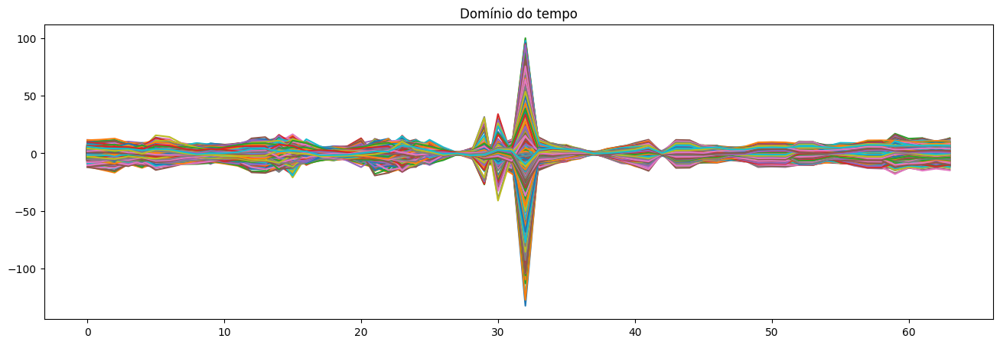

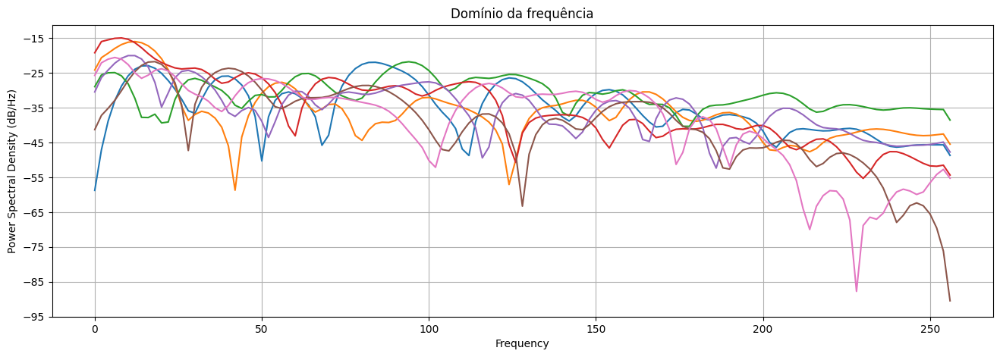

/tmp/ipykernel_16192/1856478781.py:13: UserWarning: Only one segment is calculated since parameter NFFT (=256) >= signal length (=64).
  plt.specgram(data[i,:], Fs=512)


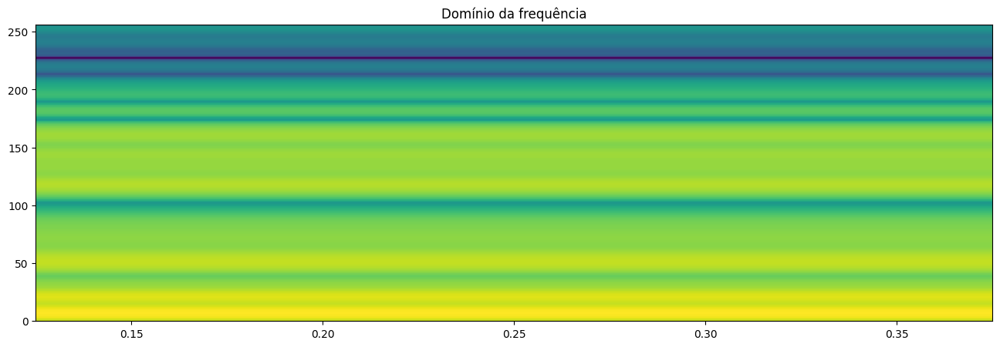

In [15]:
# definição dos tamanhos das figuras
rcParams['figure.figsize'] = [16., 5.]
print_graphs(data)

In [16]:
# criação de um objeto "info"
n_channels = 64
sfreq = 250
# Eletrodos do aparelho
ch_names = [
    "FP1", "FPZ", "FP2", "AF3", "AF4", "F7", "F5", 
    "F3", "F1", "FZ", "F2", "F4", 
    "F6", "F8", "FT7", "FC5", "FC3", 
    "FC1", "FCZ", "FC2", 
    "FC4", "FC6", "FT8", "T7", "C5", 
    "C3", "C1", "CZ", "C2", 
    "C4", "C6", "T8", "M1", 
    "TP7", "CP5", "CP3", "CP1", "CPZ", "CP2", "CP4", "CP6", 
    "TP8", "M2", "P7", "P5", 
    "P3", "P1", "PZ", "P2", "P4", "P6", 
    "P8", "PO7", "PO5", "PO3", 
    "POZ", "PO4", "PO6", "PO8", "CB1", "O1", "OZ", "O2", "CB2"
    ]
ch_types = ['eeg'] * n_channels
info = mne.create_info(ch_names, sfreq=sfreq, ch_types=ch_types)
info


<Info | 7 non-empty values
 bads: []
 ch_names: FP1, FPZ, FP2, AF3, AF4, F7, F5, F3, F1, FZ, F2, F4, F6, F8, ...
 chs: 64 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: unspecified
 nchan: 64
 projs: []
 sfreq: 250.0 Hz
>

In [17]:
from sklearn.preprocessing import LabelEncoder

labels = np.load("../datasets/beta/labels.npy")
print(labels, labels.shape)

[ 8.6  8.8  9.   9.2  9.4  9.6  9.8 10.  10.2 10.4 10.6 10.8 11.  11.2
 11.4 11.6 11.8 12.  12.2 12.4 12.6 12.8 13.  13.2 13.4 13.6 13.8 14.
 14.2 14.4 14.6 14.8 15.  15.2 15.4 15.6 15.8  8.   8.2  8.4  8.6  8.8
  9.   9.2  9.4  9.6  9.8 10.  10.2 10.4 10.6 10.8 11.  11.2 11.4 11.6
 11.8 12.  12.2 12.4 12.6 12.8 13.  13.2 13.4 13.6 13.8 14.  14.2 14.4
 14.6 14.8 15.  15.2 15.4 15.6 15.8  8.   8.2  8.4  8.6  8.8  9.   9.2
  9.4  9.6  9.8 10.  10.2 10.4 10.6 10.8 11.  11.2 11.4 11.6 11.8 12.
 12.2 12.4 12.6 12.8 13.  13.2 13.4 13.6 13.8 14.  14.2 14.4 14.6 14.8
 15.  15.2 15.4 15.6 15.8  8.   8.2  8.4  8.6  8.8  9.   9.2  9.4  9.6
  9.8 10.  10.2 10.4 10.6 10.8 11.  11.2 11.4 11.6 11.8 12.  12.2 12.4
 12.6 12.8 13.  13.2 13.4 13.6 13.8 14.  14.2 14.4 14.6 14.8 15.  15.2
 15.4 15.6 15.8  8.   8.2  8.4] (160,)


In [18]:
data_correct = data
# adicionando labels do sinal
labels = np.load("../datasets/beta/labels.npy")
# método para transformar labels categoricos
le = LabelEncoder()
events = np.column_stack((
    np.array(range(len(labels))),
    np.zeros(160, dtype=int),
    le.fit_transform(labels))
)

event_dict = {str(value): index  for index, value in enumerate(sorted(set(labels)))}

mne_data = mne.EpochsArray(data_correct, info, events, event_id=event_dict)
channels_to_keep = [ch for ch in mne_data.info['ch_names'] if ch.startswith('PO') or ch.startswith('Pz') or ch.startswith('O')]
channels_to_drop = [ch for ch in mne_data.info['ch_names'] if ch not in channels_to_keep]
print(channels_to_drop)
mne_data = mne_data.drop_channels(channels_to_drop)
filtered_mne_data = mne_data.filter(7, 17)
filtered_mne_data.save("beta_epo.fif", overwrite=True)

Not setting metadata
160 matching events found
No baseline correction applied
0 projection items activated
['FP1', 'FPZ', 'FP2', 'AF3', 'AF4', 'F7', 'F5', 'F3', 'F1', 'FZ', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC5', 'FC3', 'FC1', 'FCZ', 'FC2', 'FC4', 'FC6', 'FT8', 'T7', 'C5', 'C3', 'C1', 'CZ', 'C2', 'C4', 'C6', 'T8', 'M1', 'TP7', 'CP5', 'CP3', 'CP1', 'CPZ', 'CP2', 'CP4', 'CP6', 'TP8', 'M2', 'P7', 'P5', 'P3', 'P1', 'PZ', 'P2', 'P4', 'P6', 'P8', 'CB1', 'CB2']
Setting up band-pass filter from 7 - 17 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 7.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 6.00 Hz)
- Upper passband edge: 17.00 Hz
- Upper transition bandwidth: 4.25 Hz (-6 dB cutoff frequency: 19.12 Hz)
- Filter length: 413 samples (1.652 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done 161 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done 287 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done 449 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done 647 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done 881 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done 1151 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done 1457 tasks      | elapsed:    0.1s


/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


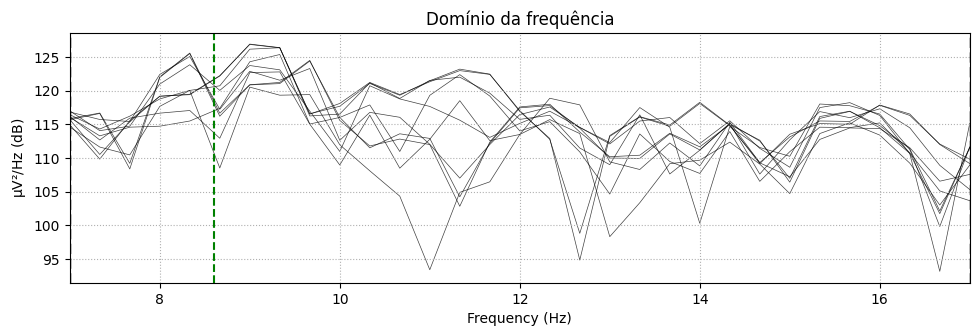

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


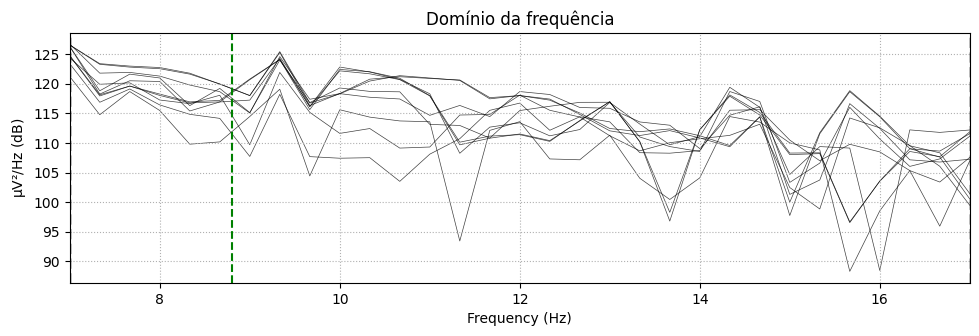

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


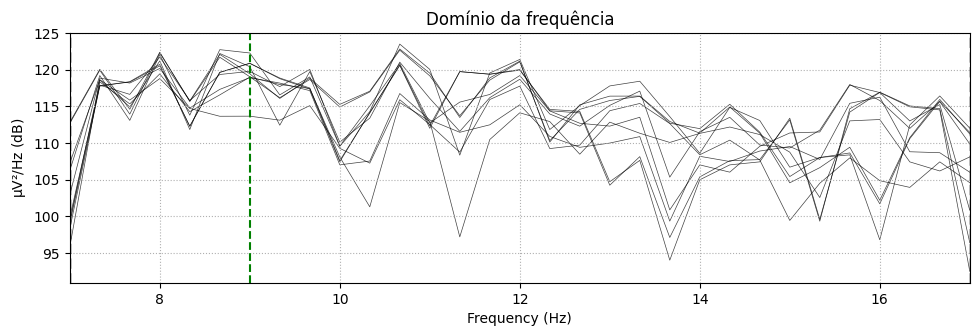

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


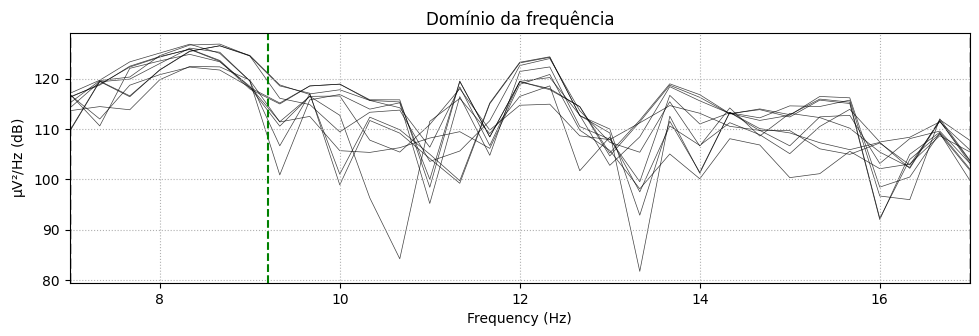

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


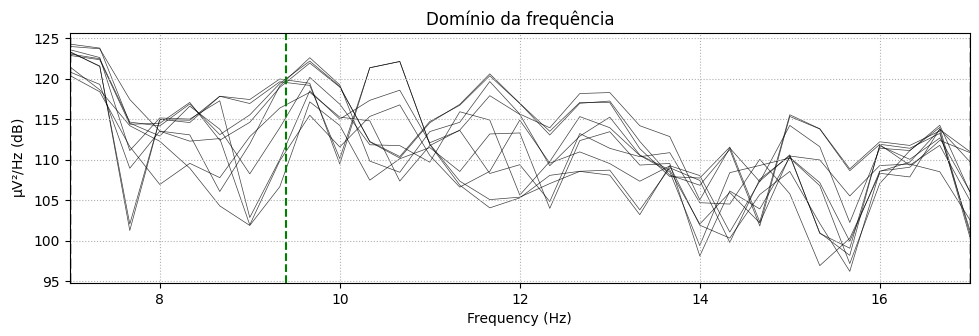

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


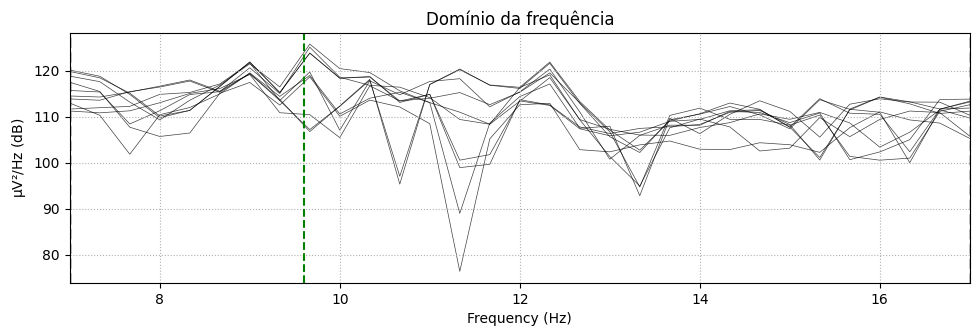

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


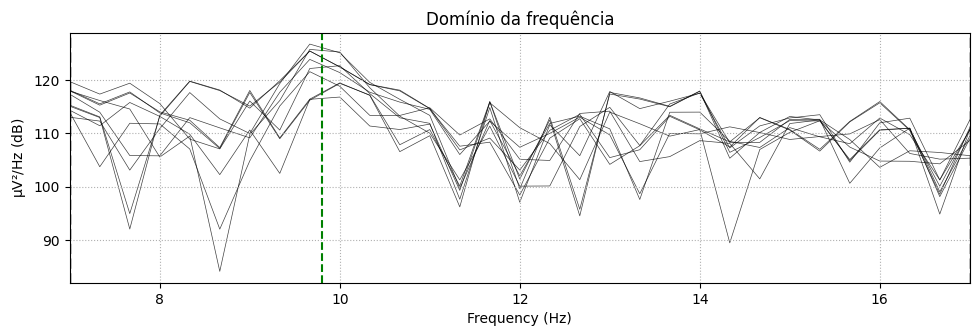

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


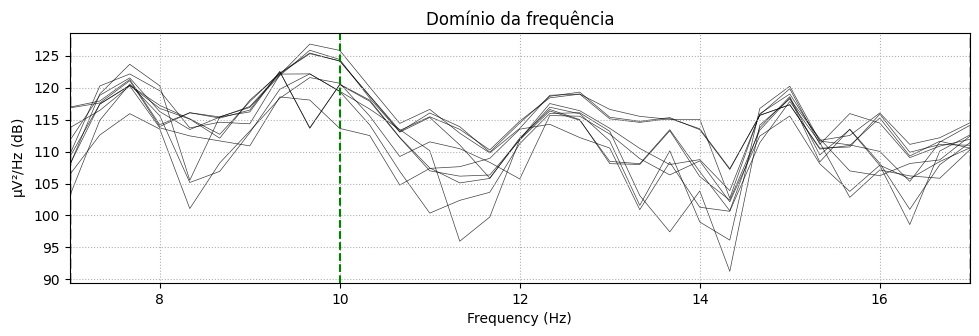

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


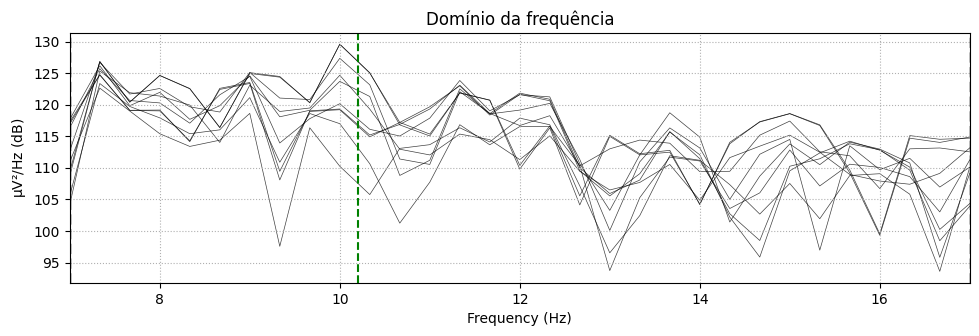

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


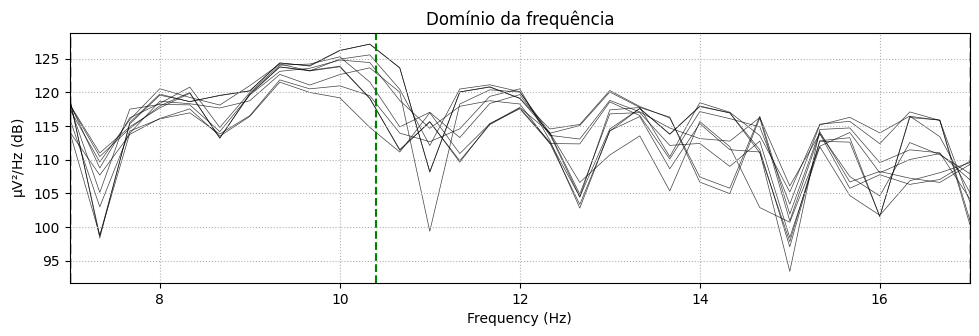

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


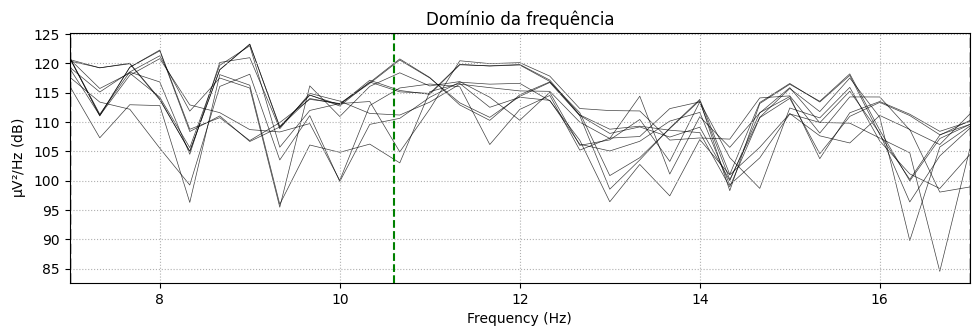

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


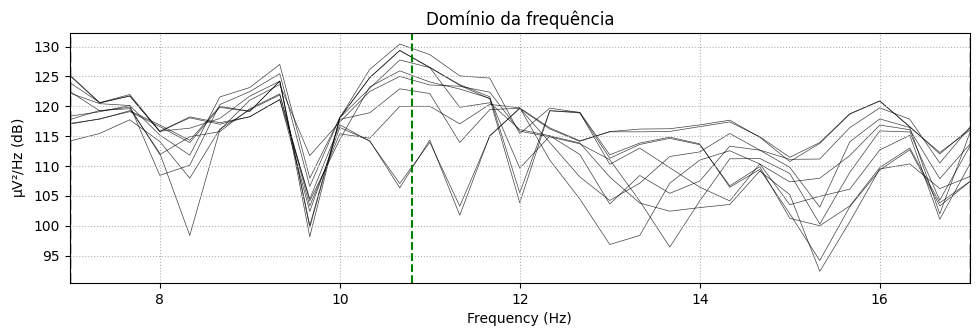

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


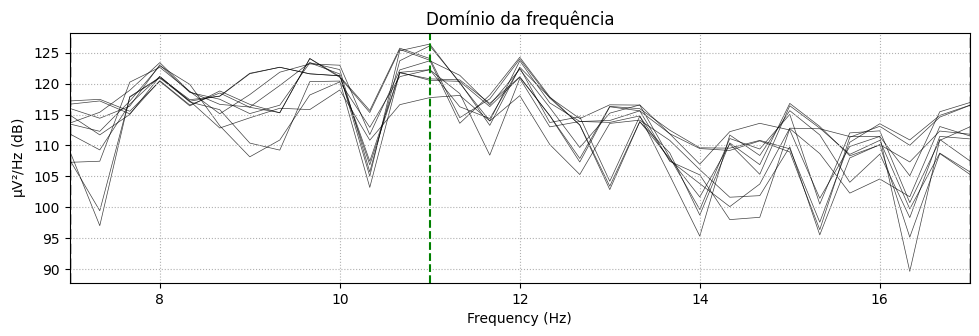

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


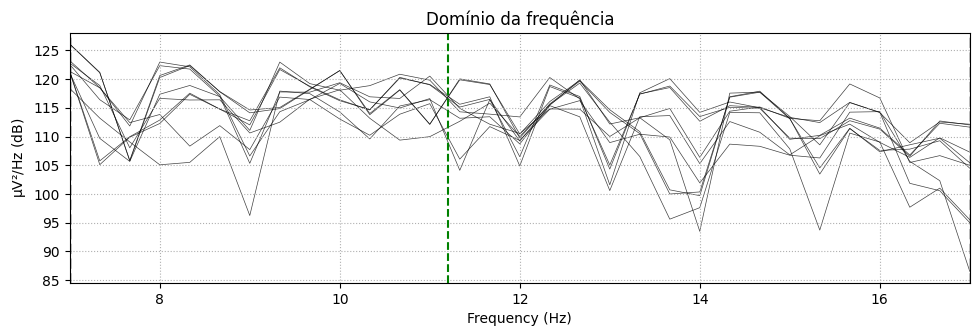

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


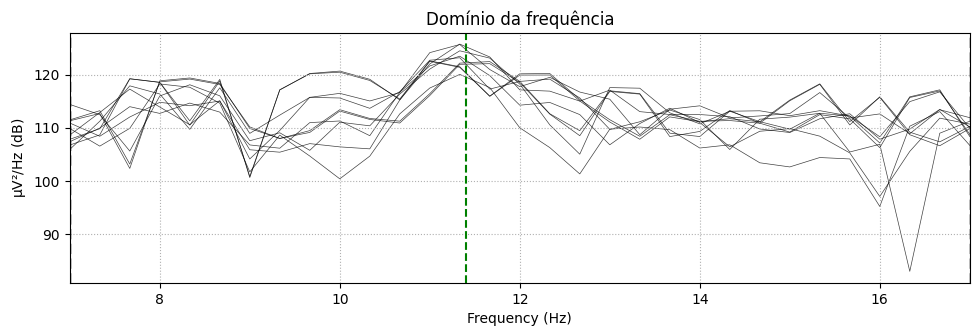

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


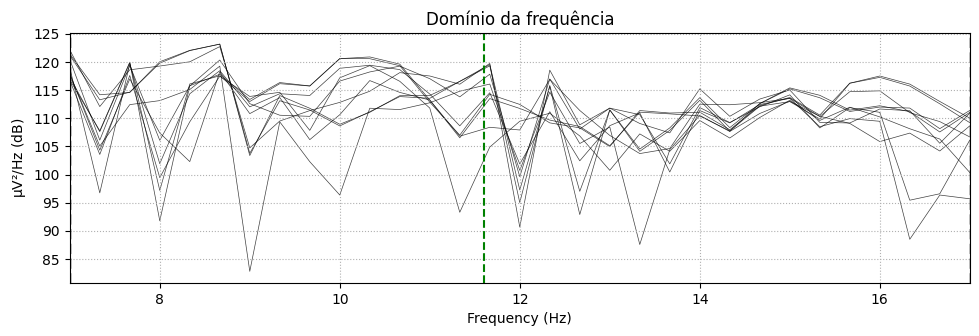

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


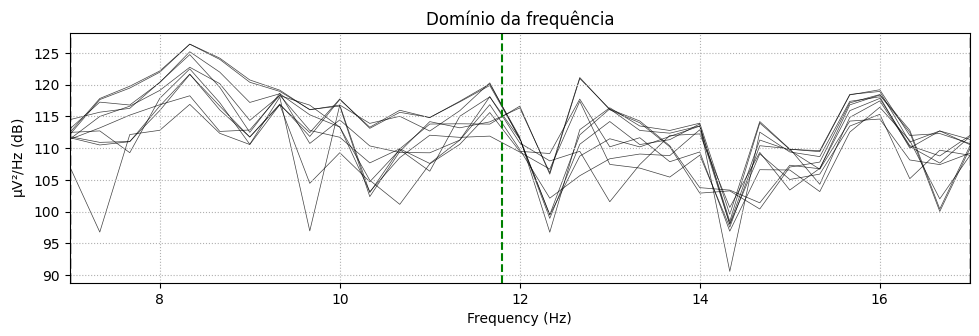

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


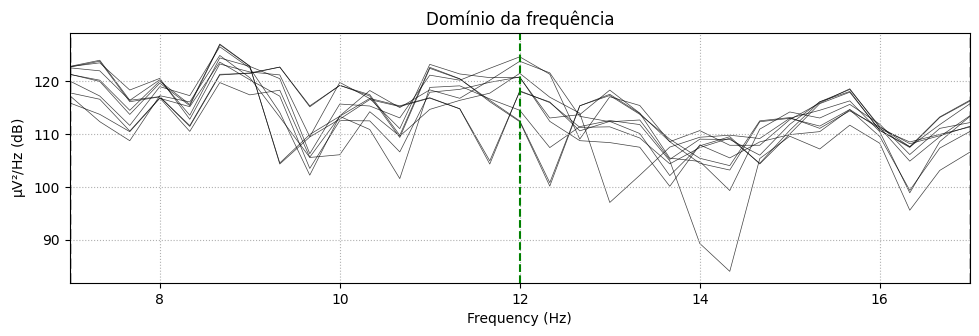

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


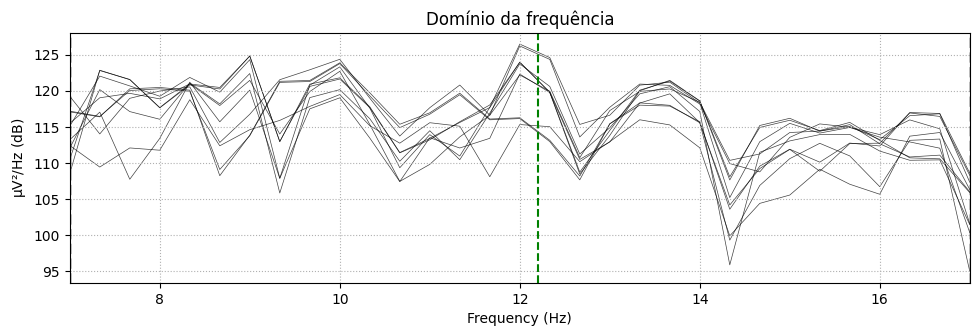

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


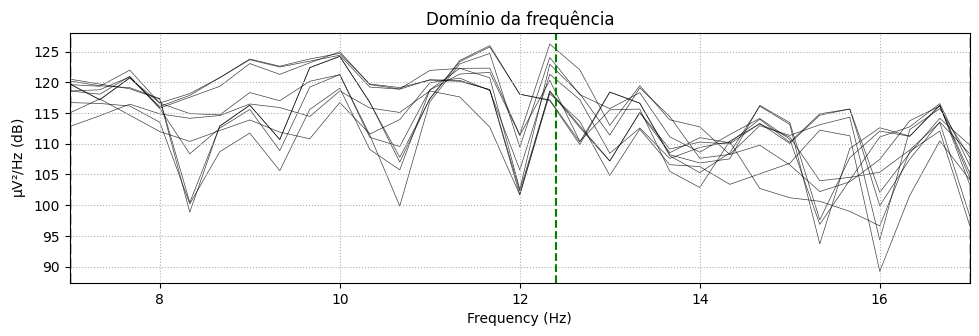

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


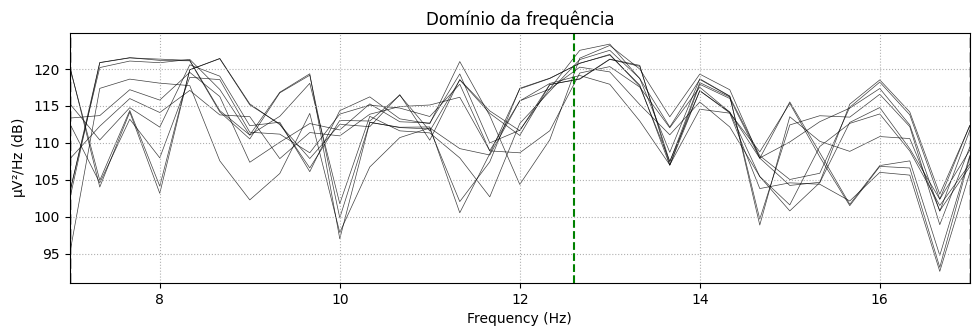

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


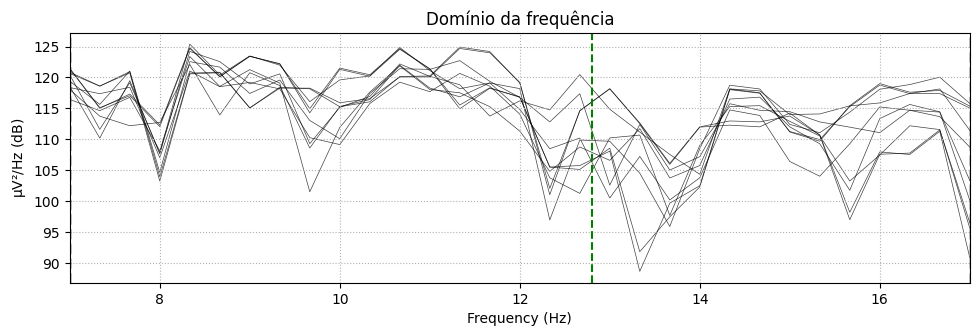

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


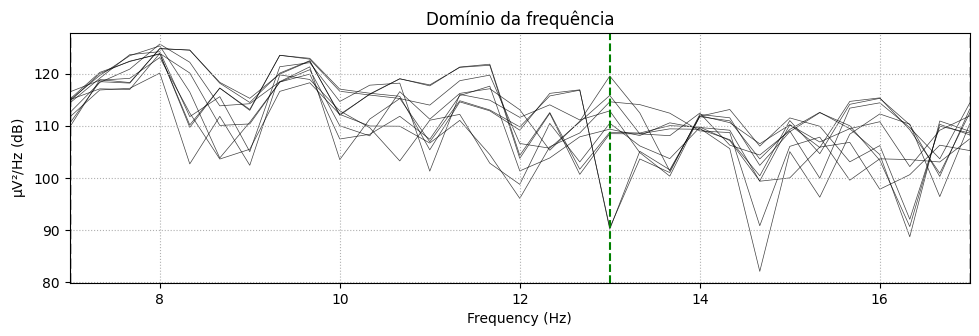

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


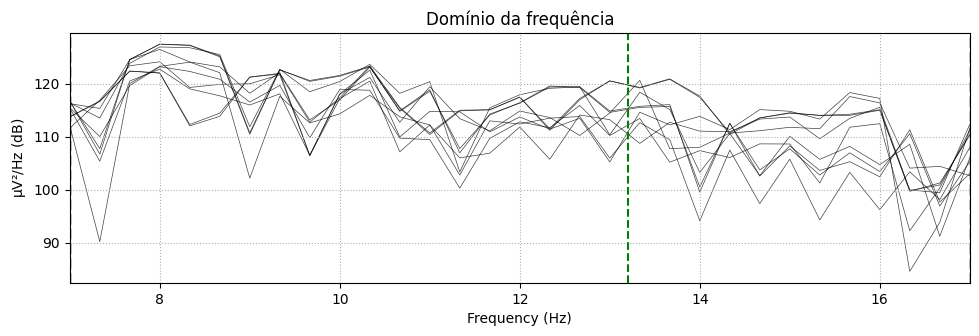

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


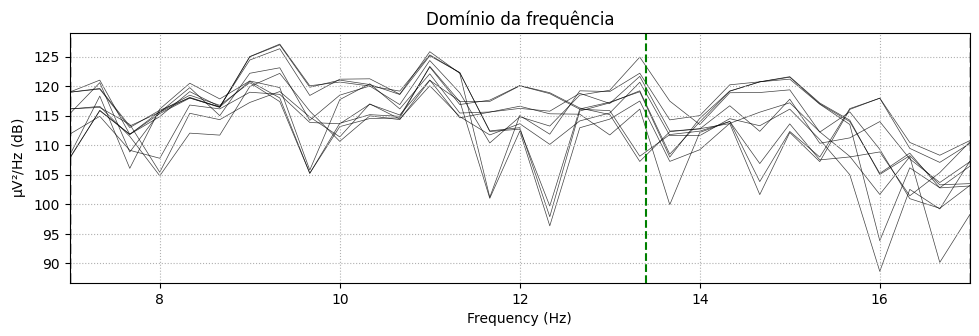

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


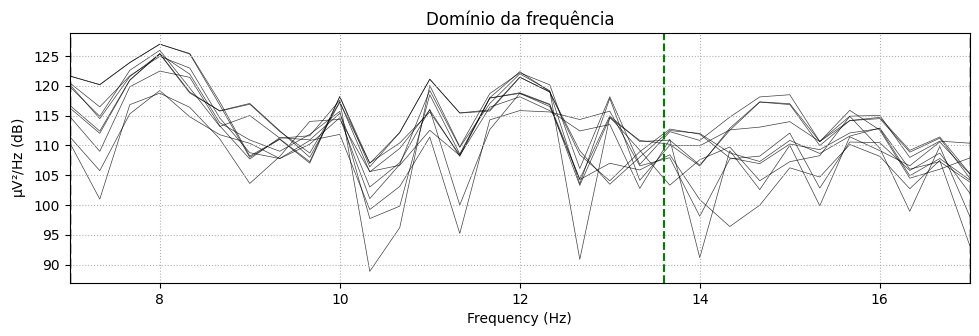

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


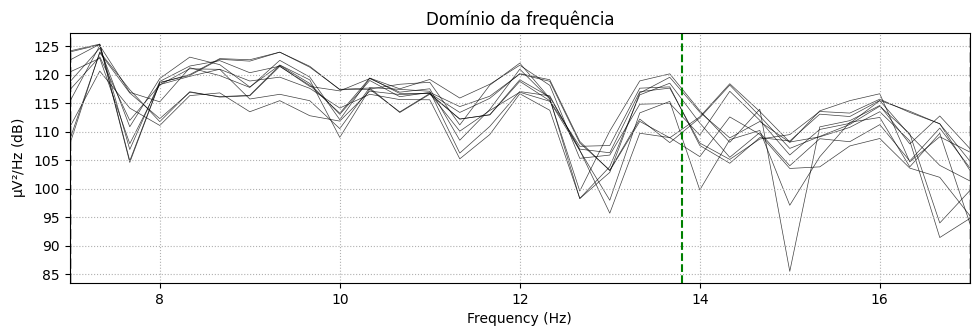

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


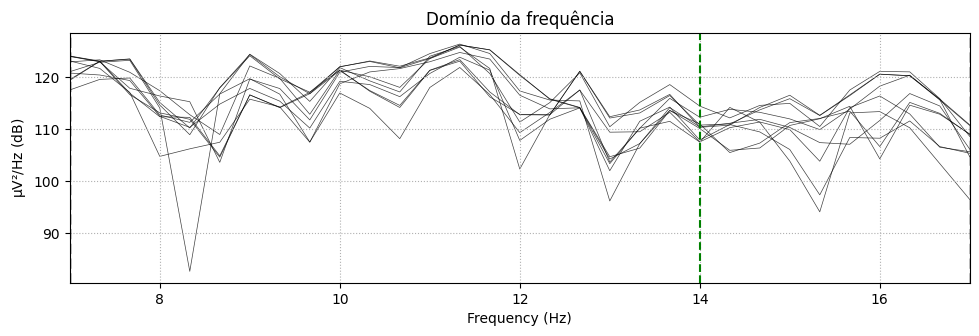

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


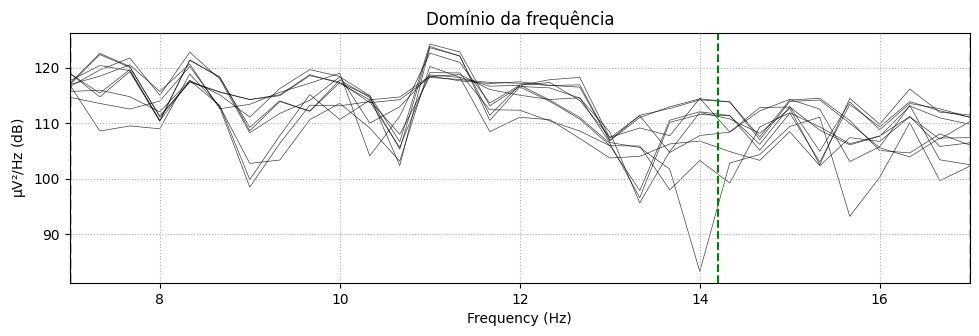

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


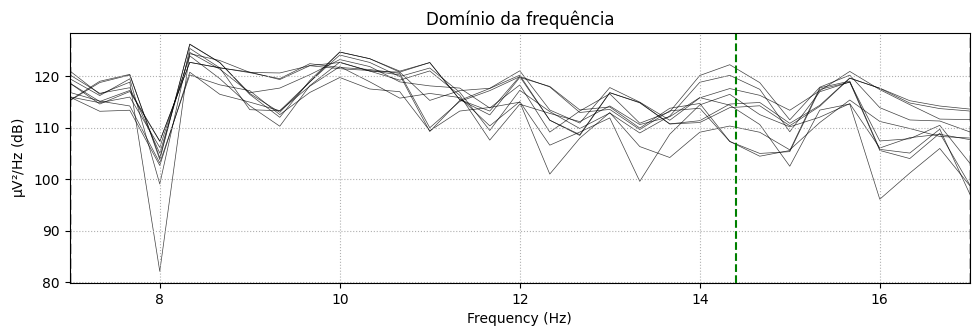

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


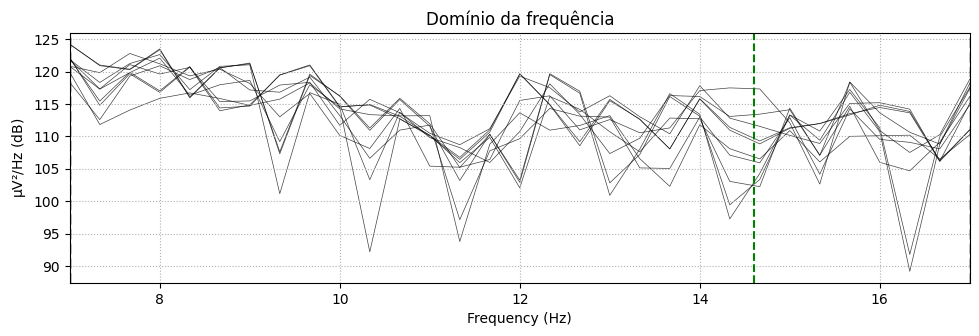

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


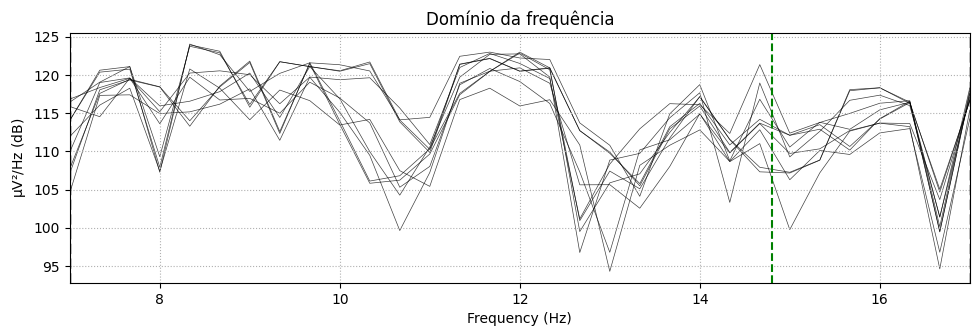

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


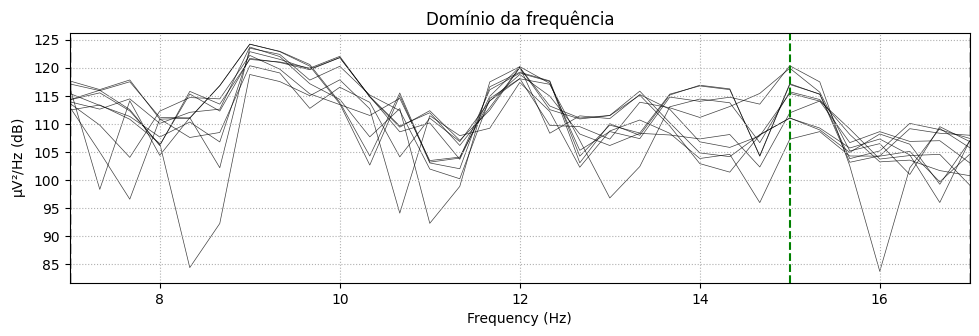

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


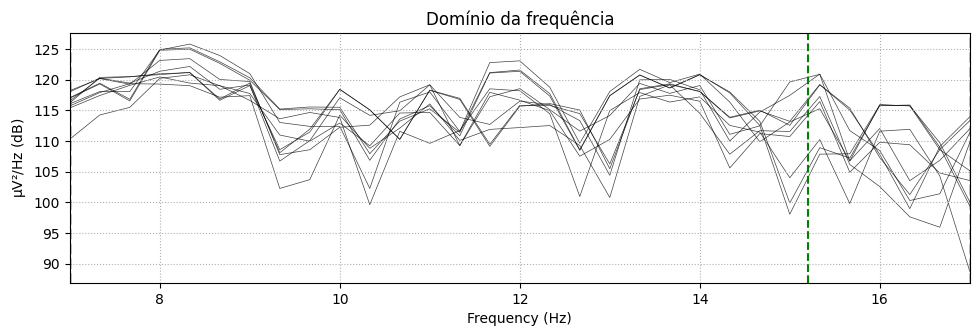

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


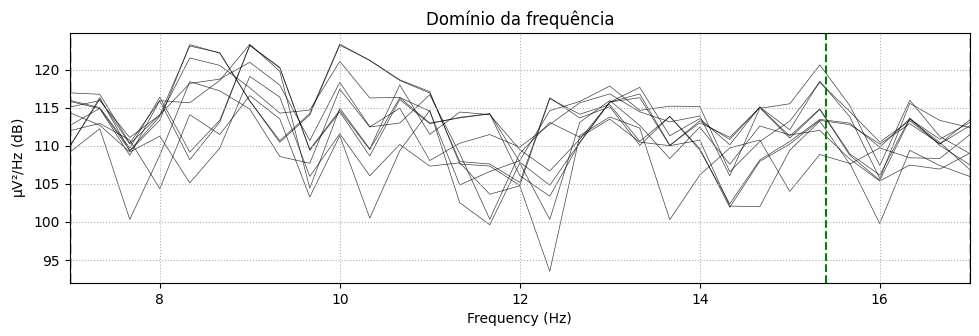

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


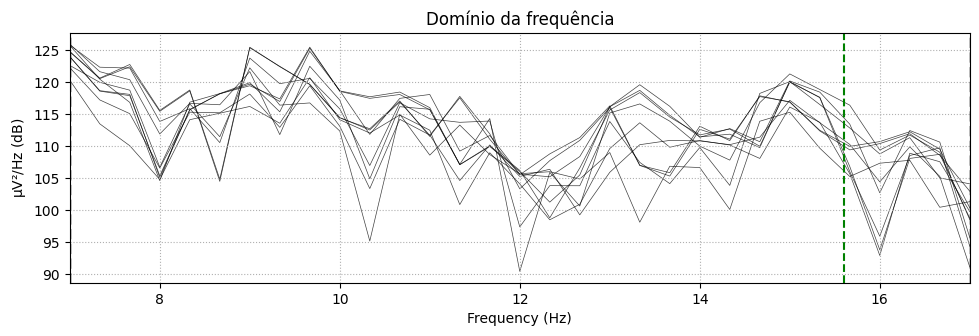

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


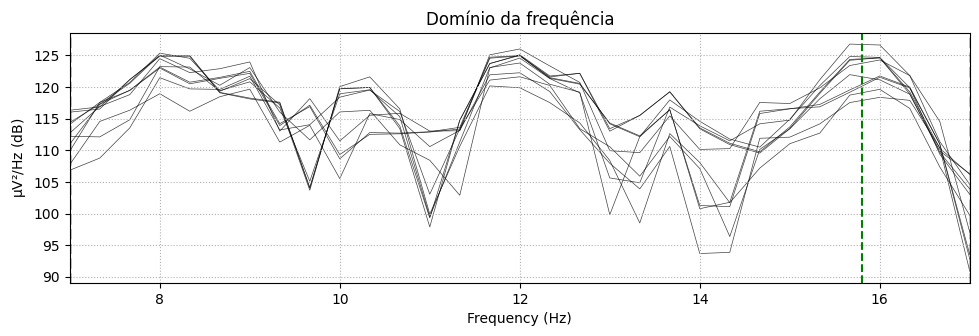

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


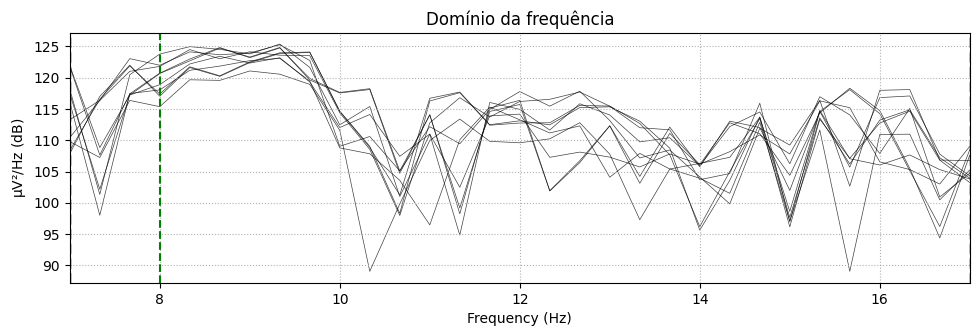

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


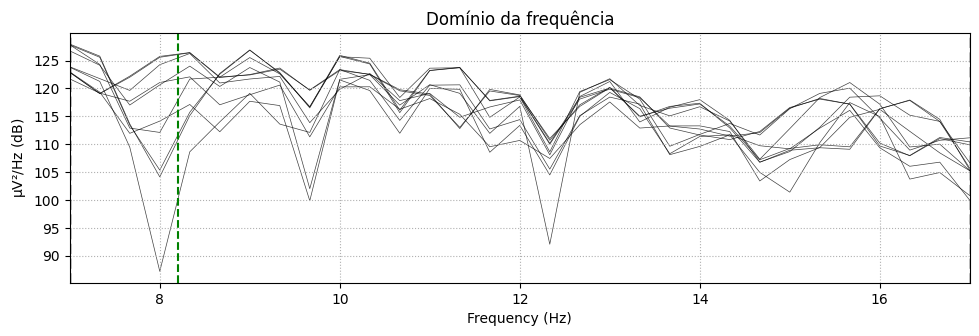

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


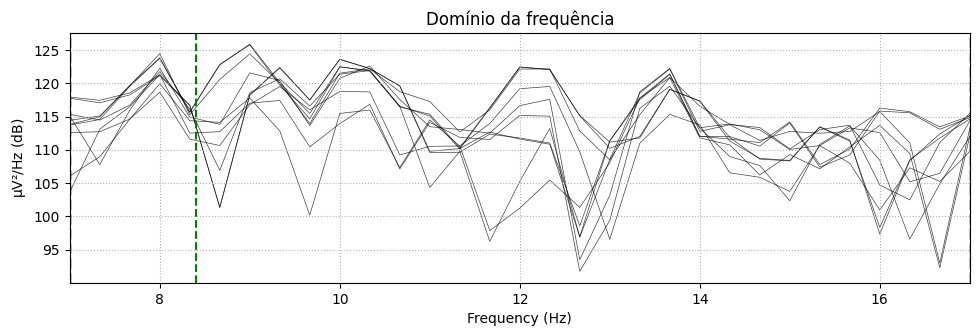

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


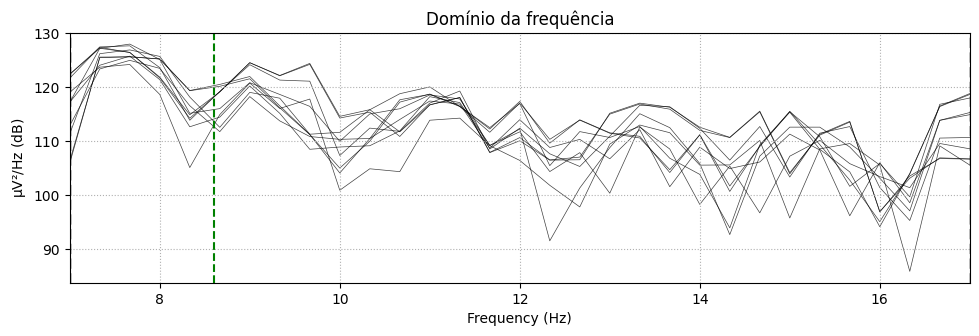

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


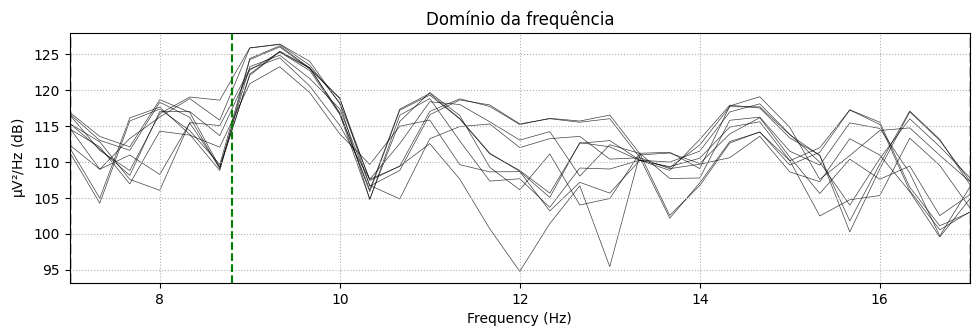

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


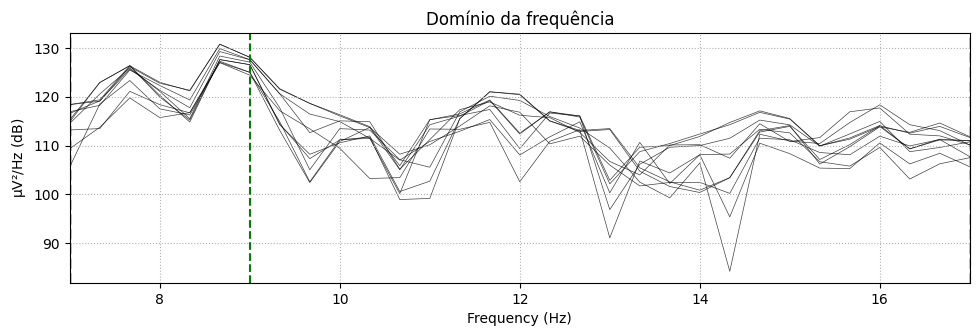

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


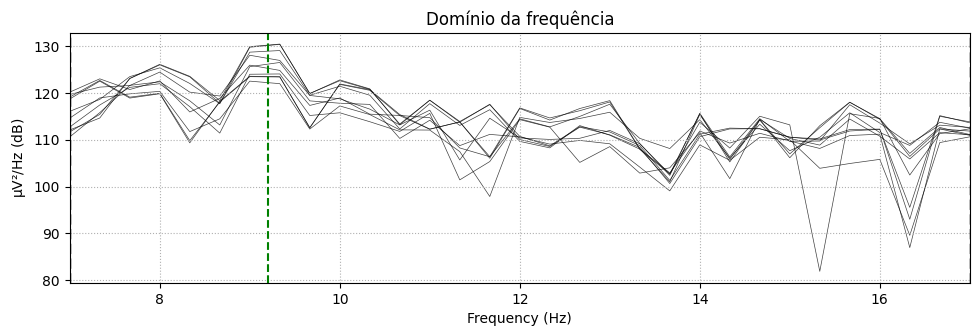

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


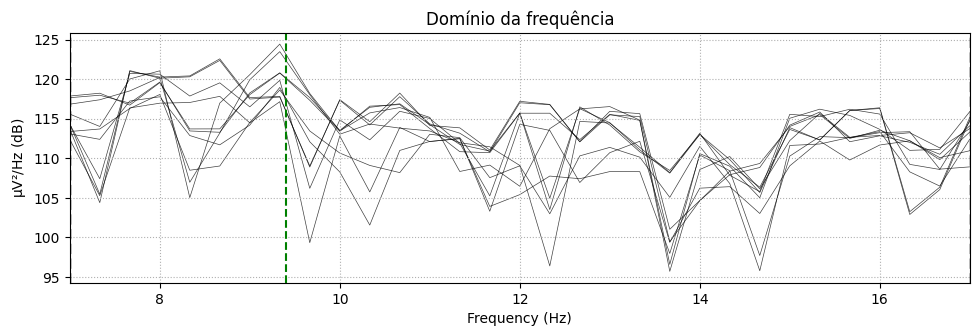

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


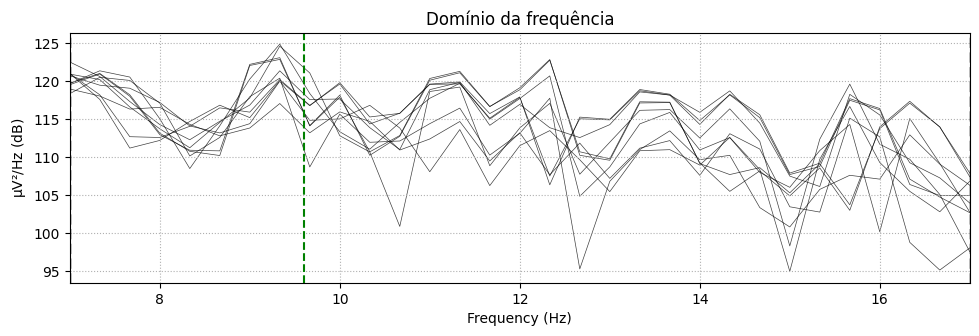

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


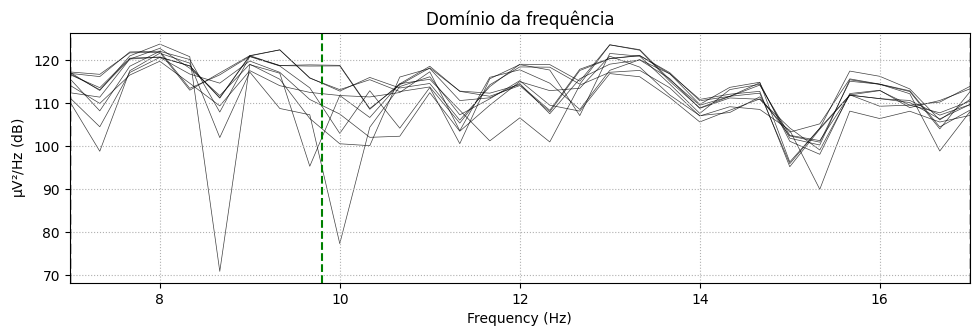

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


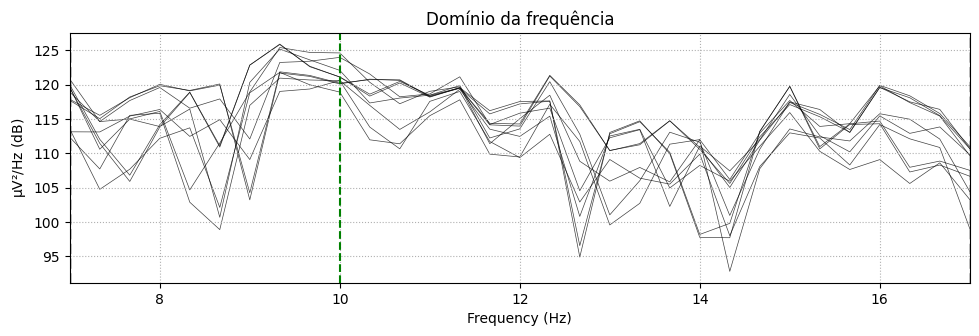

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


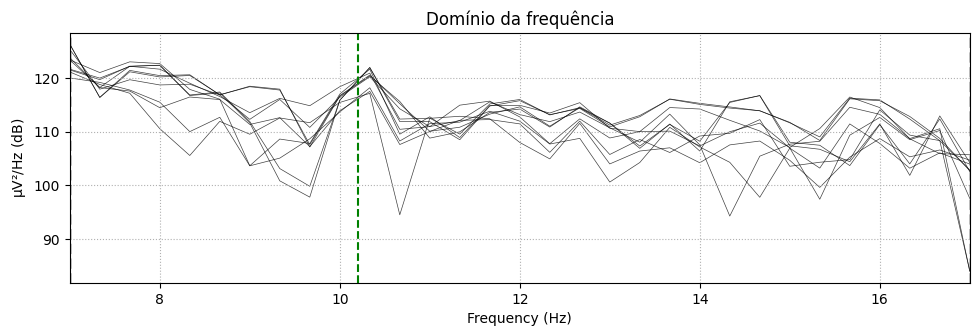

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


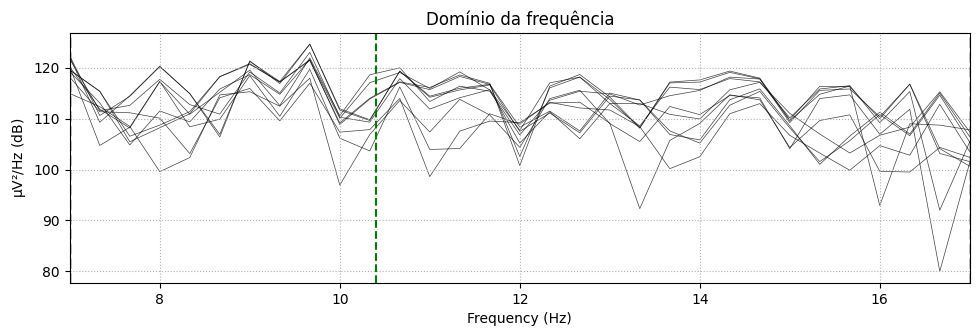

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


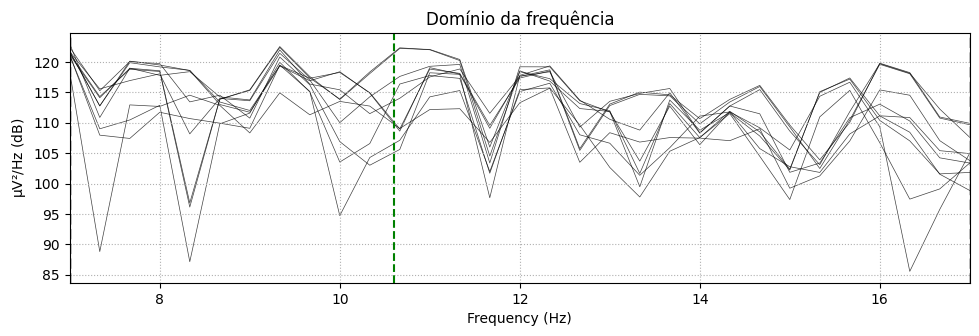

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


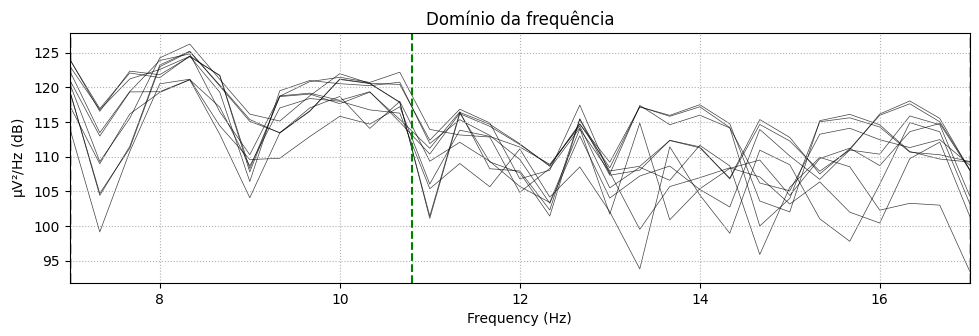

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


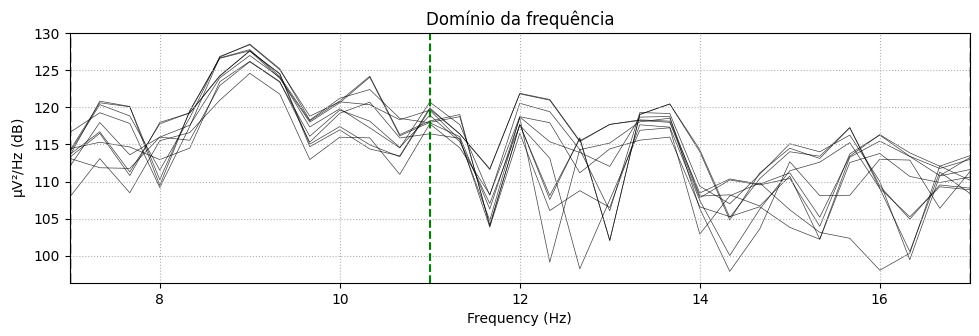

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


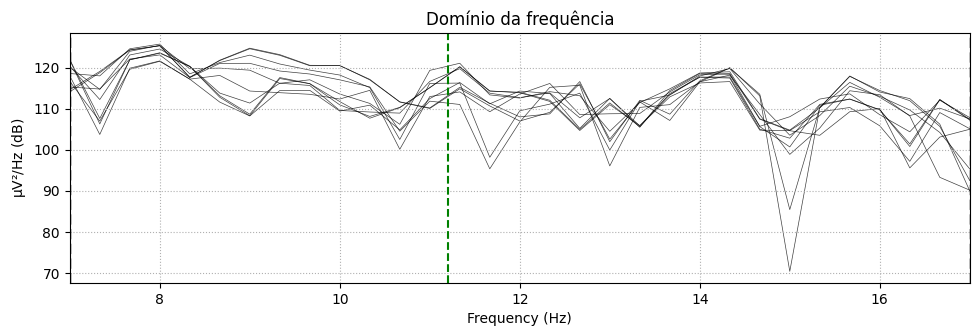

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


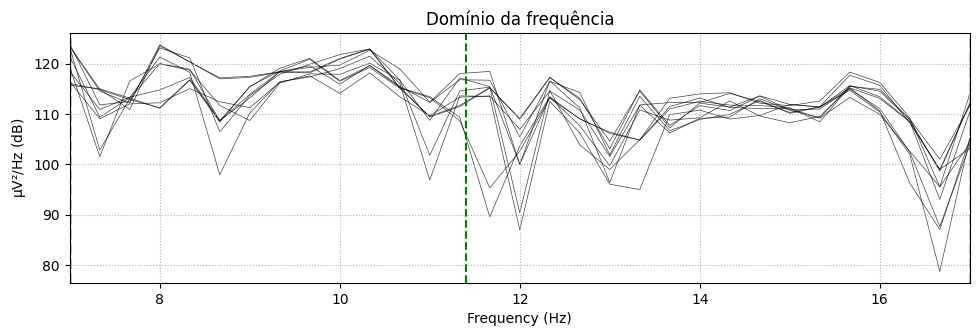

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


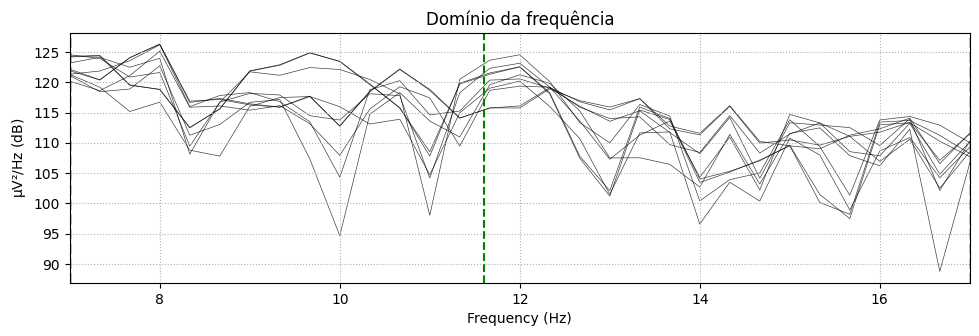

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


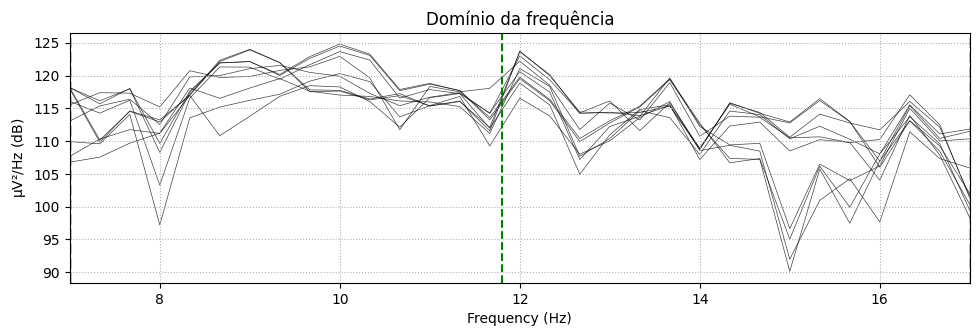

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


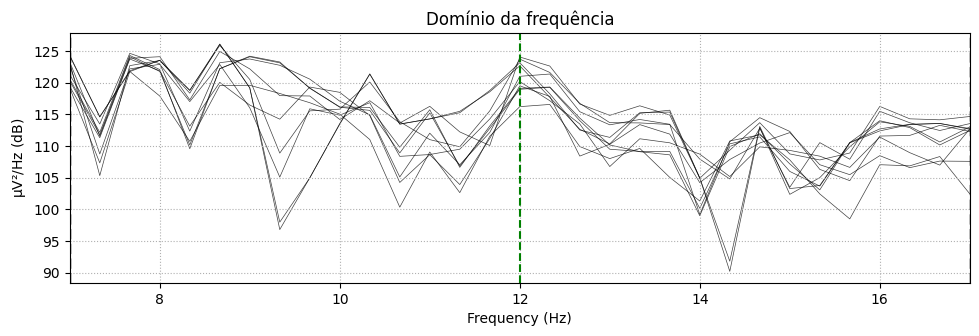

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


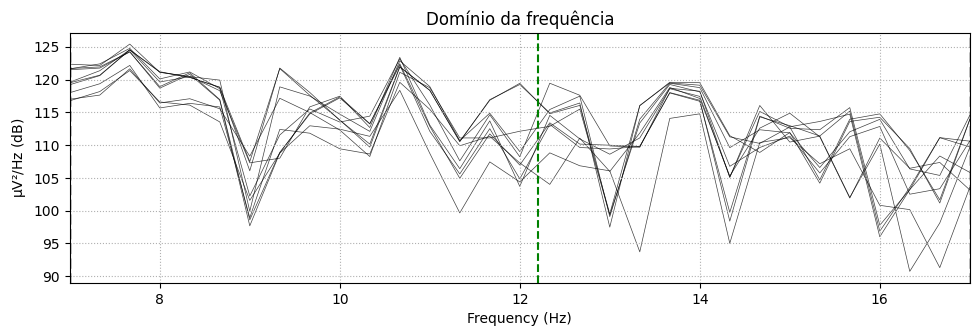

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


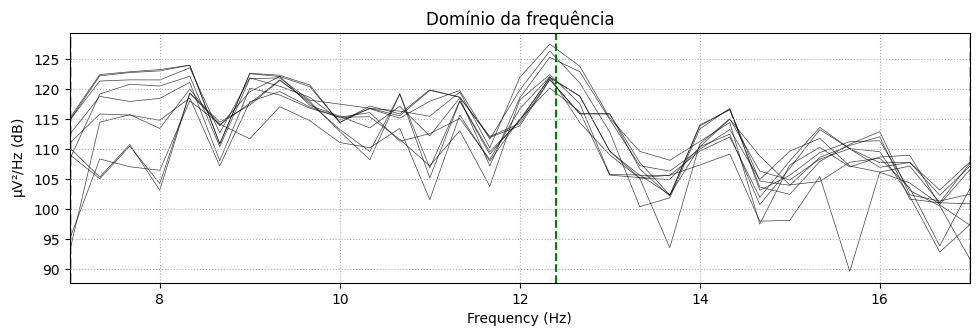

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


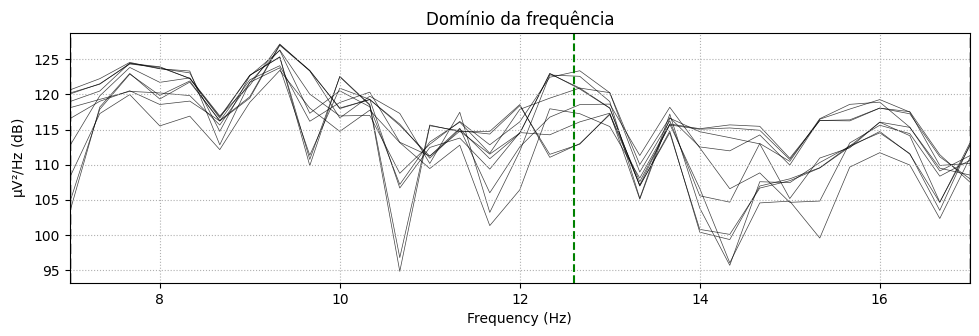

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


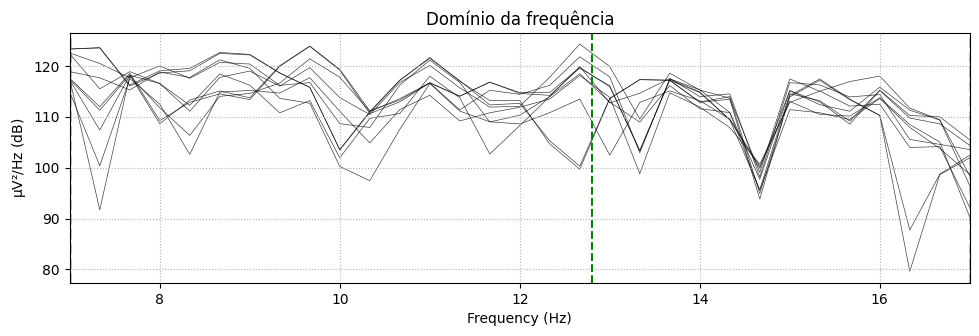

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


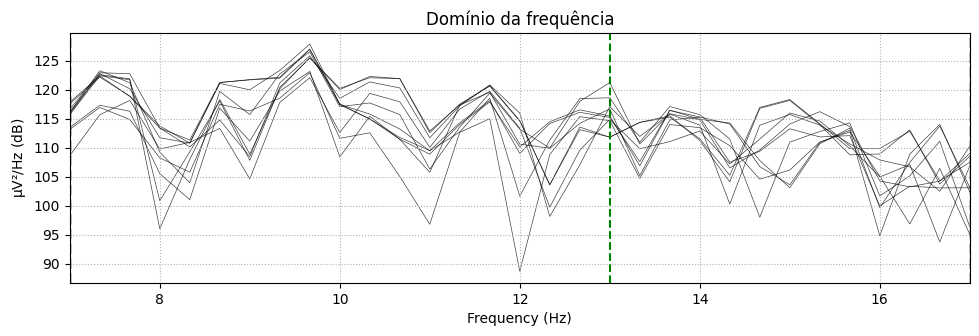

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


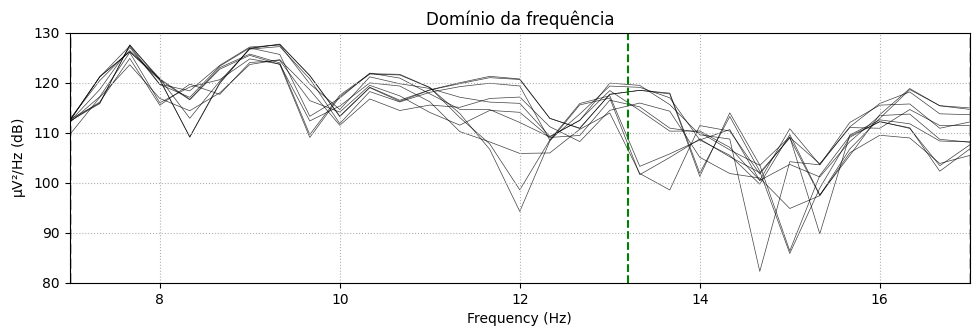

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


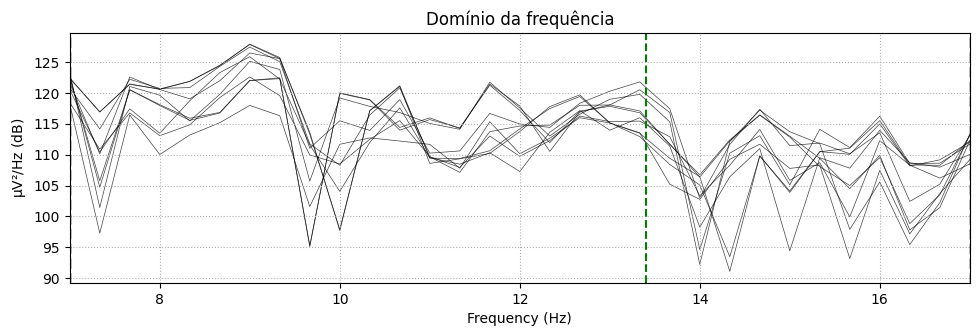

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


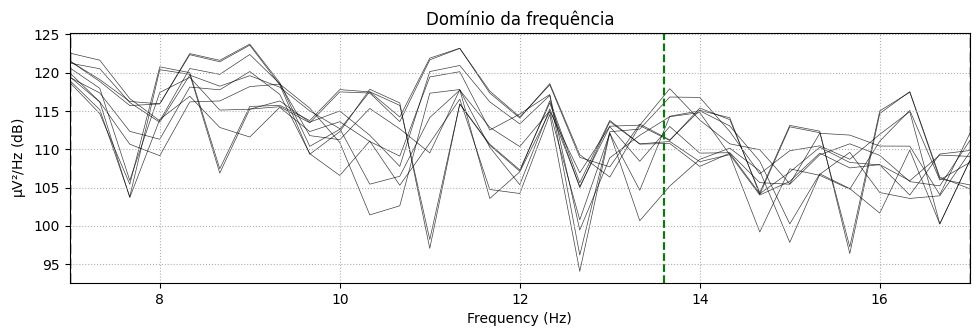

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


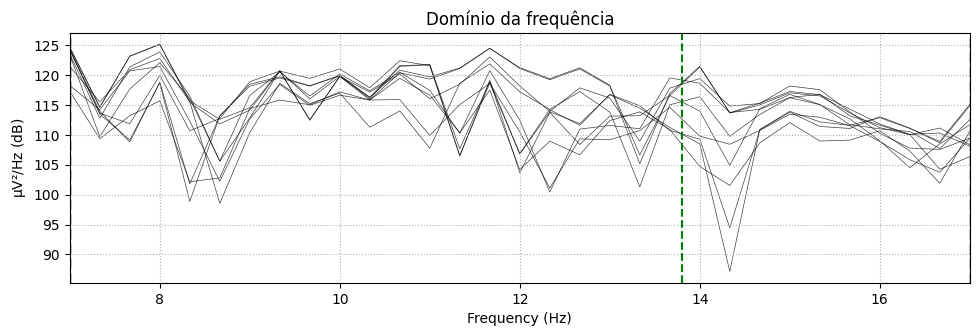

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


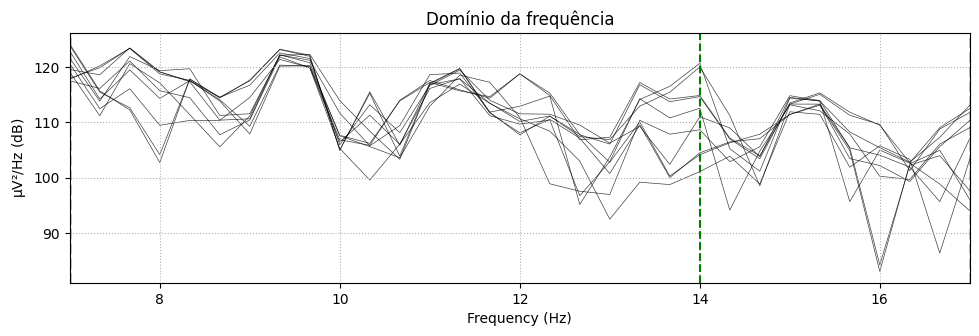

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


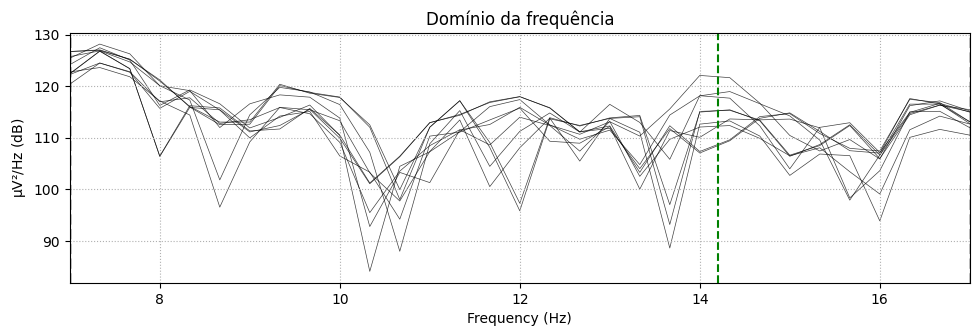

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


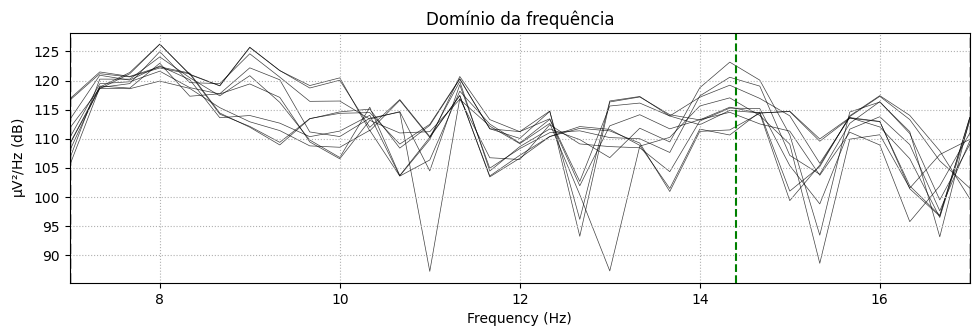

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


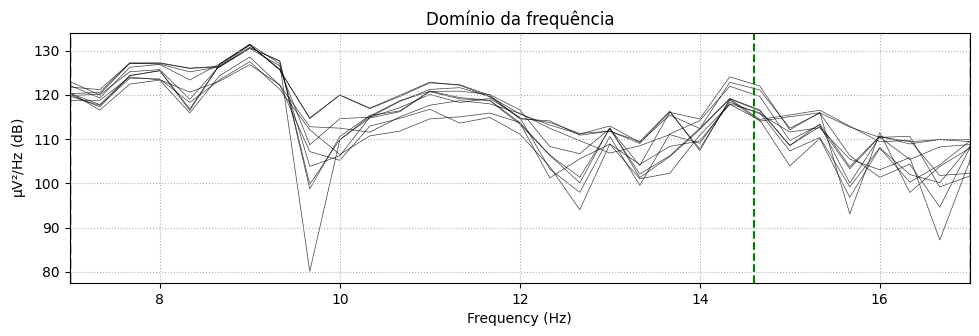

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


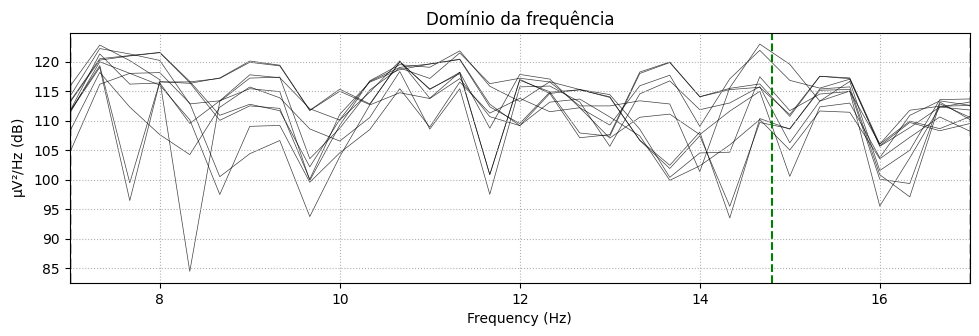

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


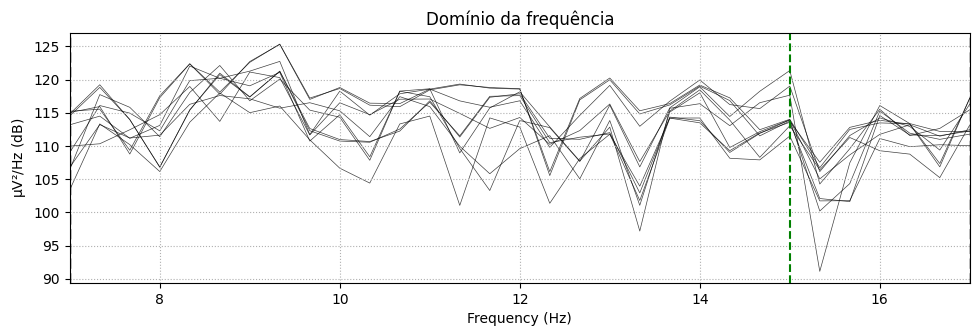

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


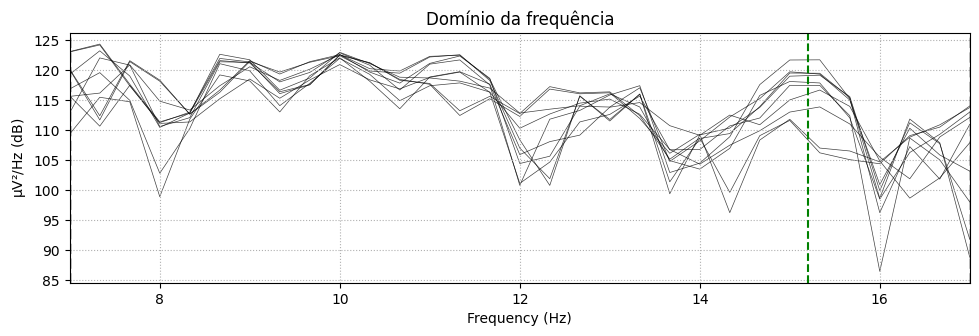

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


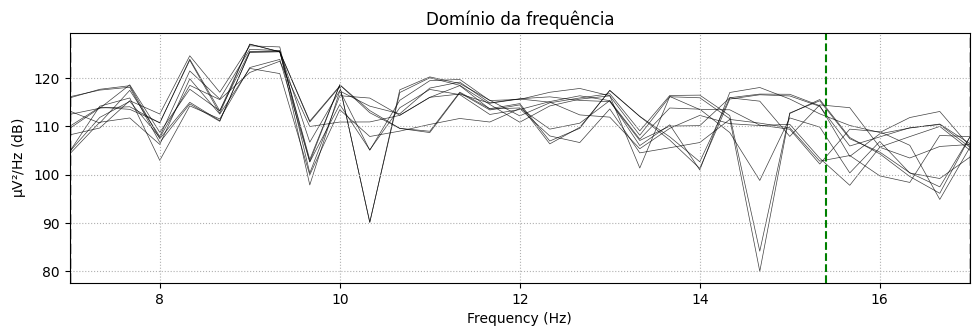

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


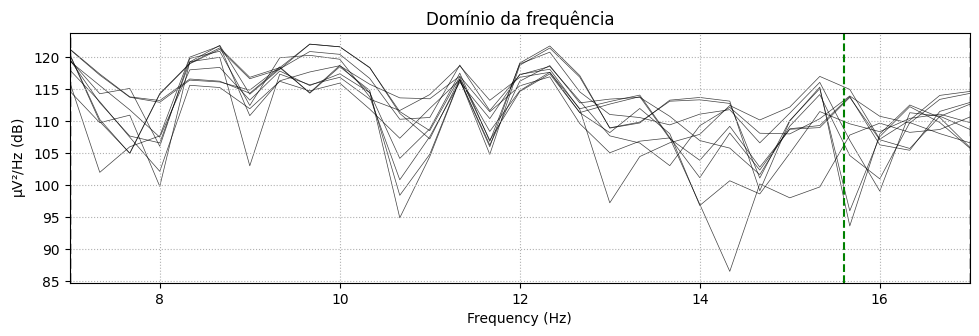

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


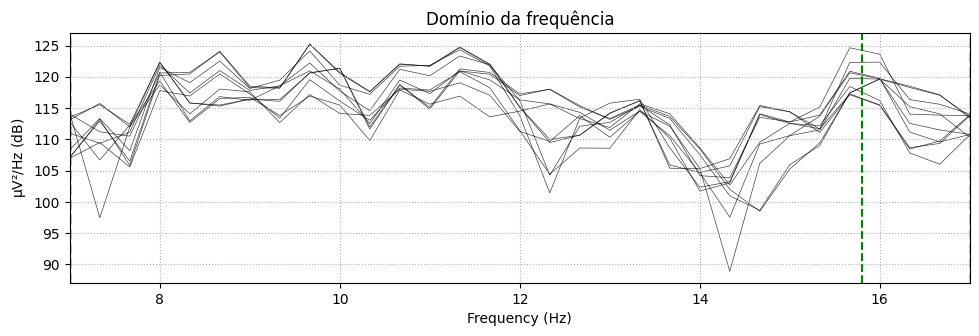

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


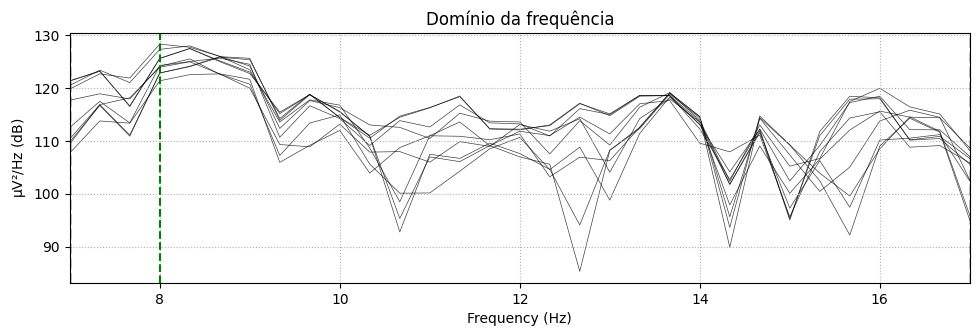

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


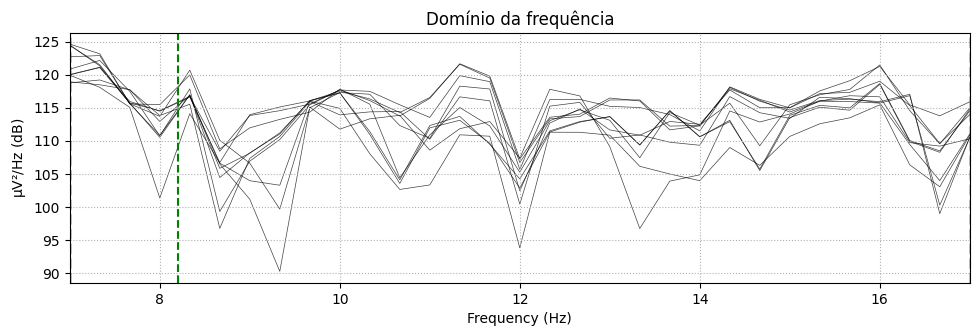

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


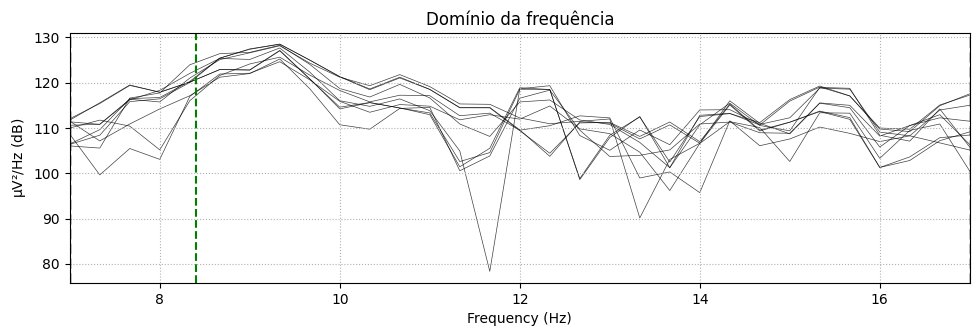

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


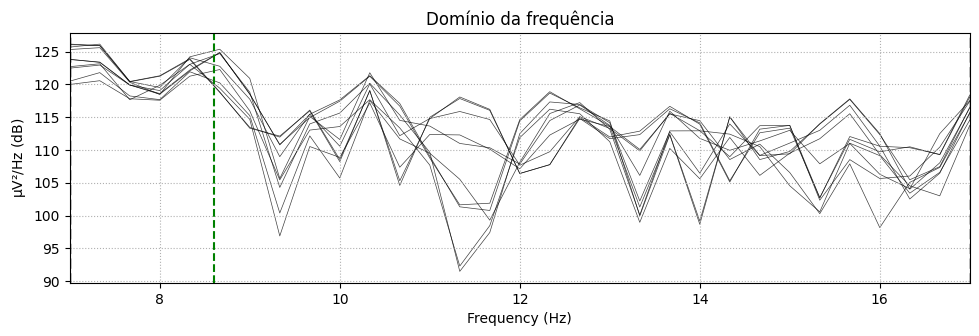

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


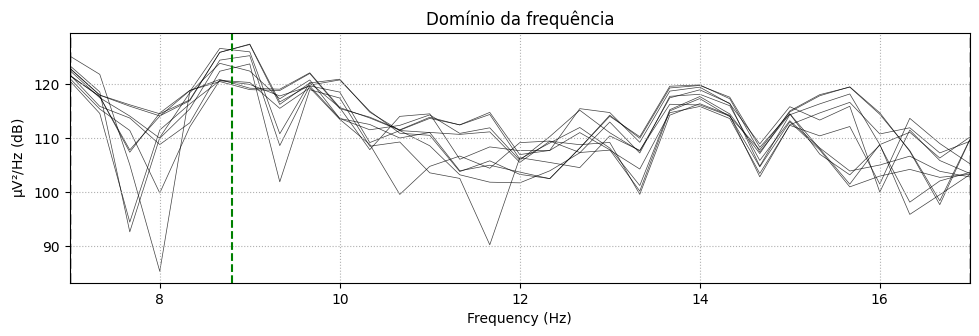

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


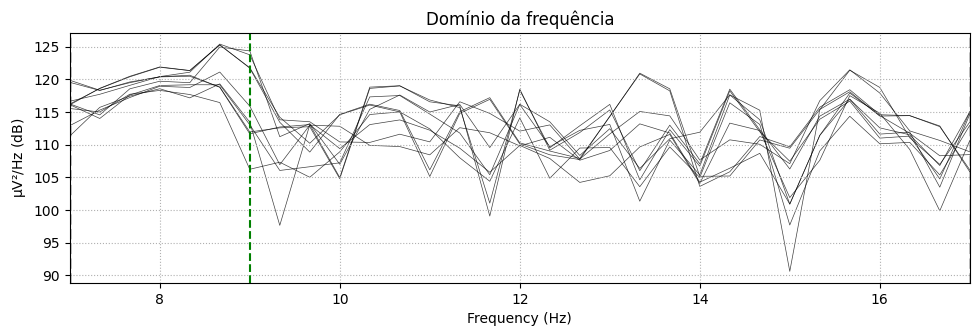

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


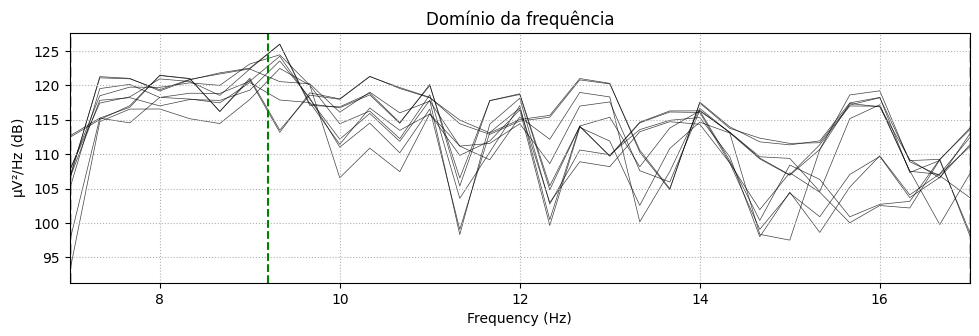

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


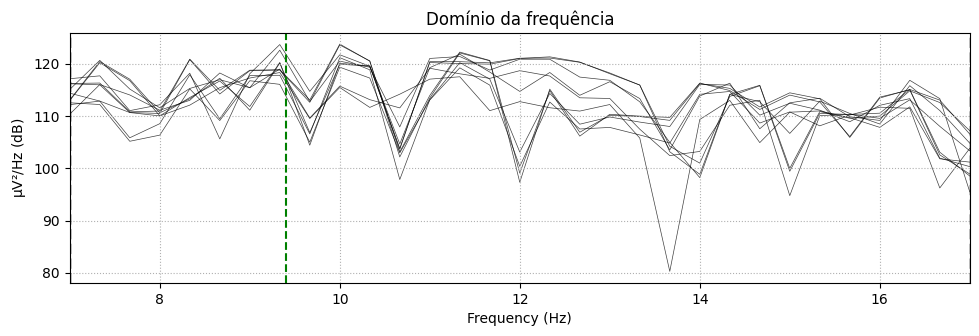

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


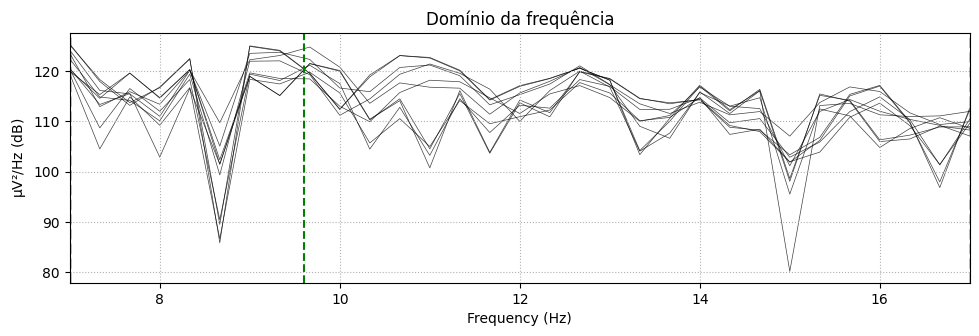

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


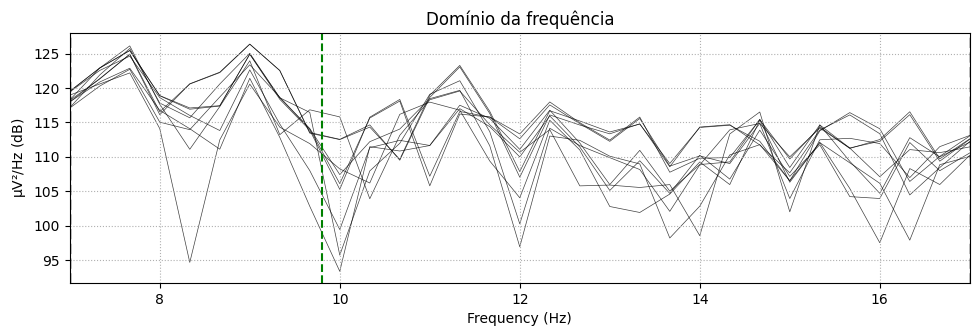

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


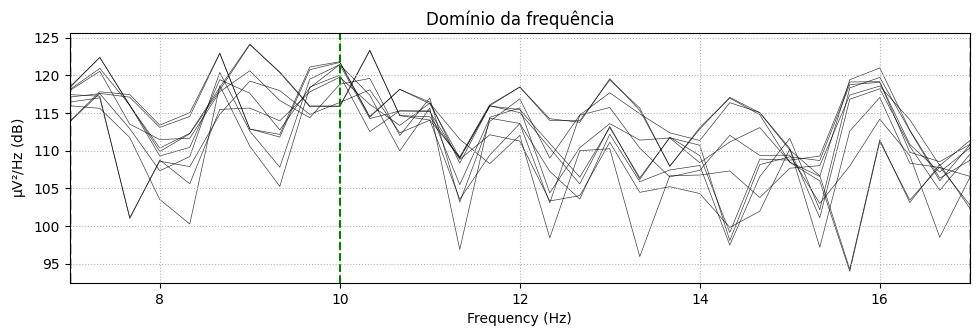

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


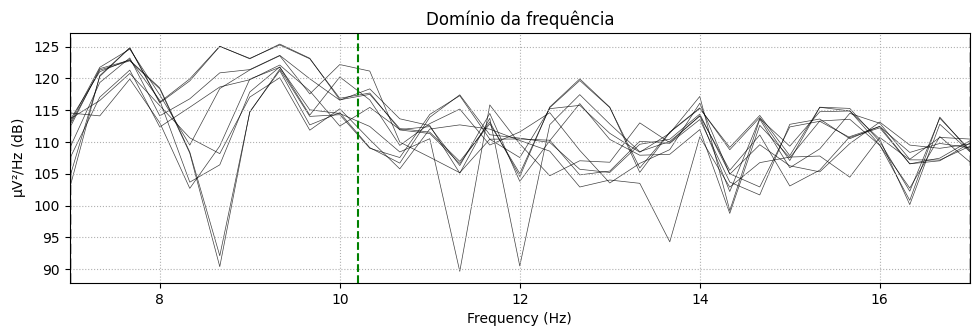

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


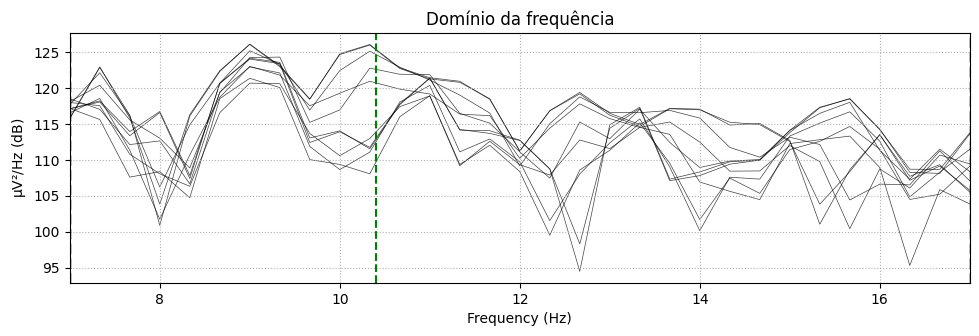

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


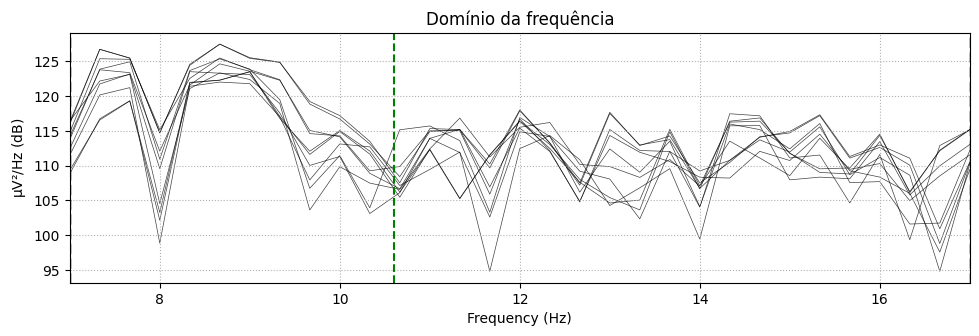

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


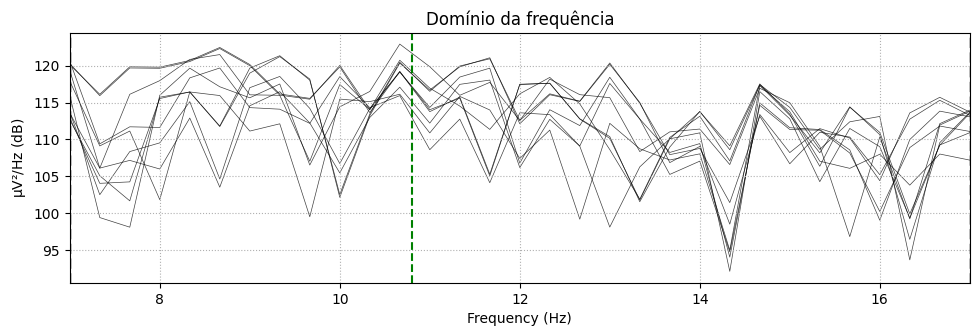

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


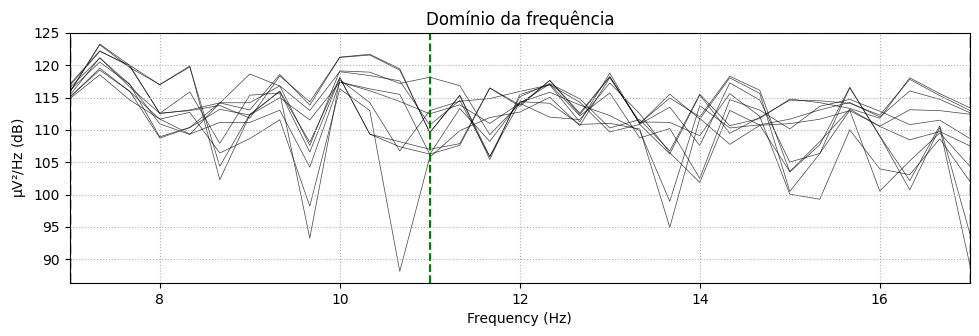

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


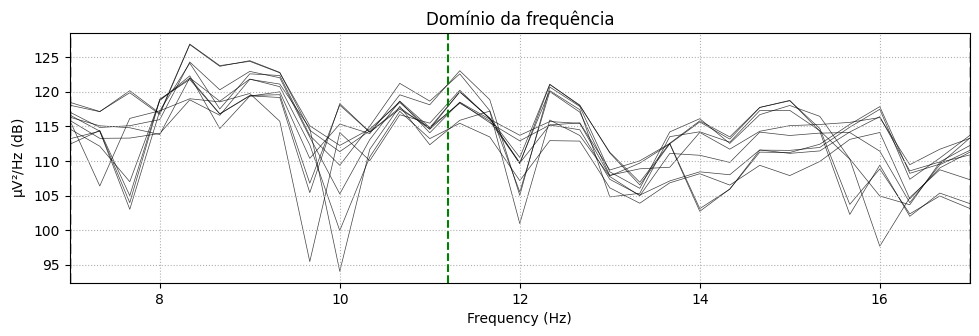

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


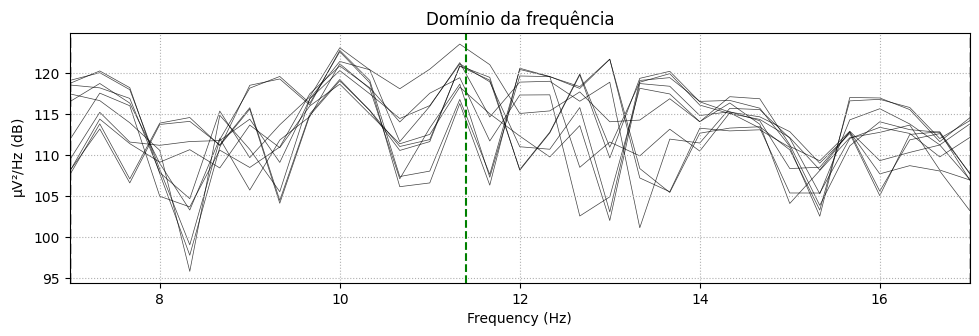

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


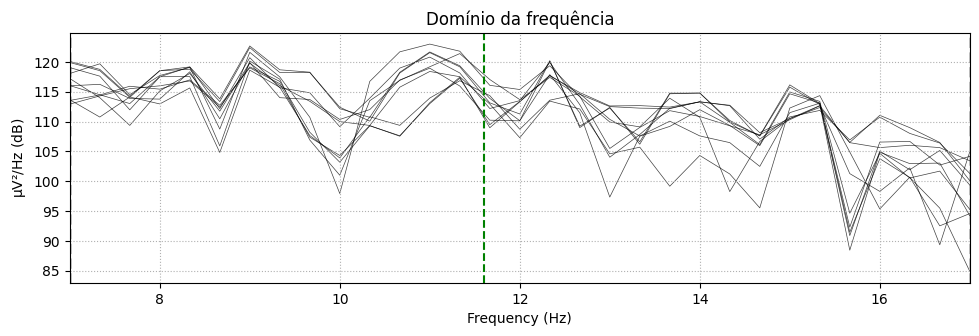

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


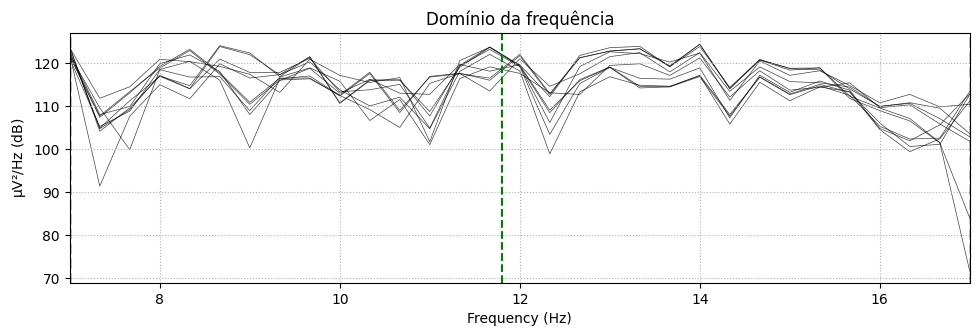

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


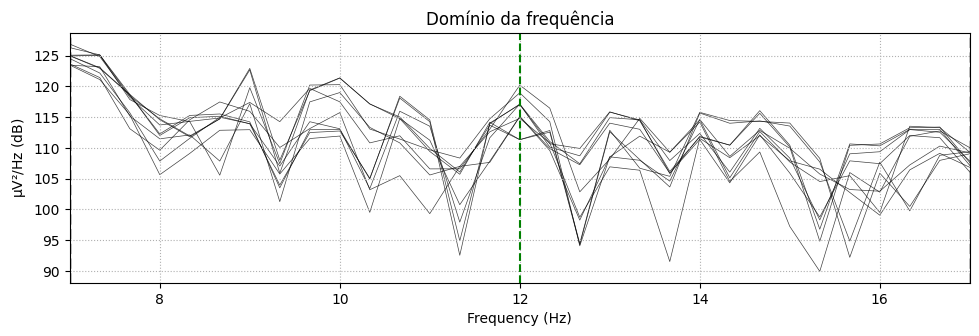

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


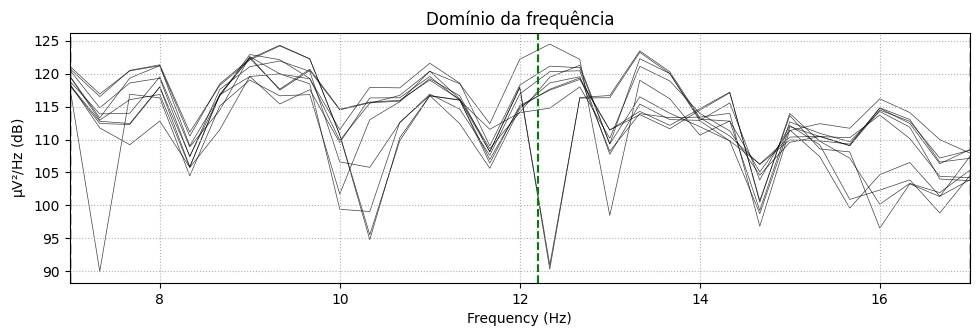

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


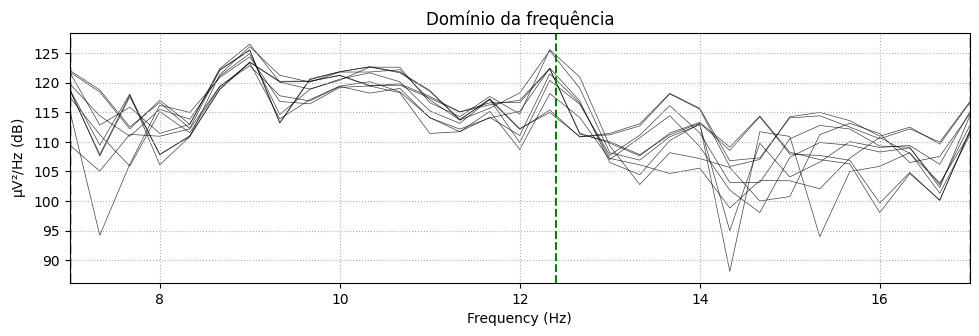

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


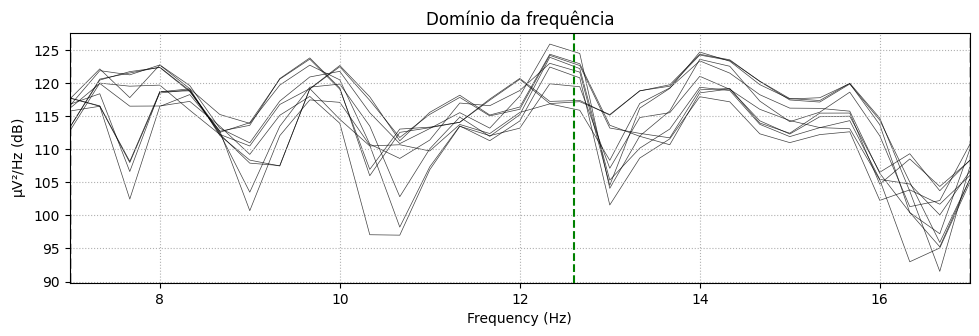

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


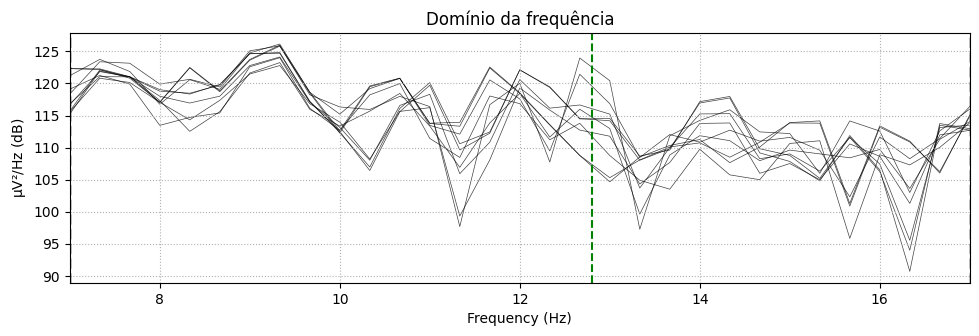

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


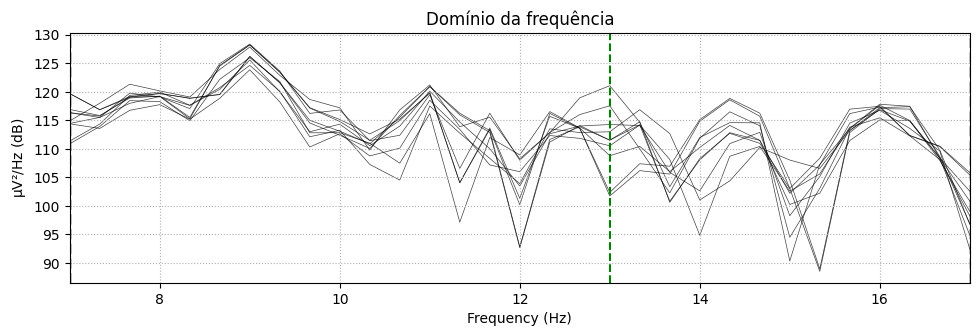

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


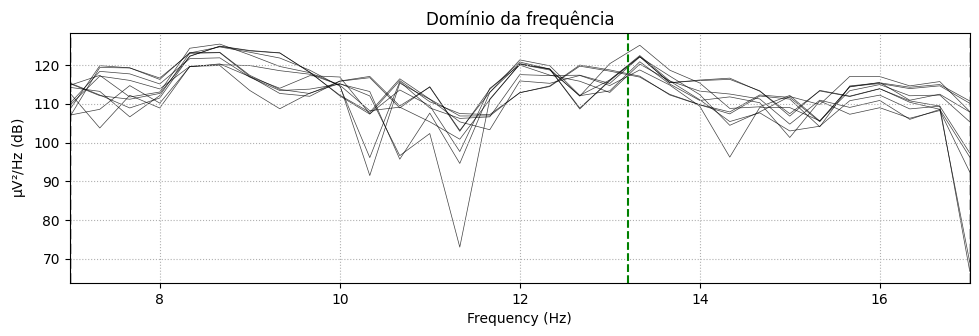

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


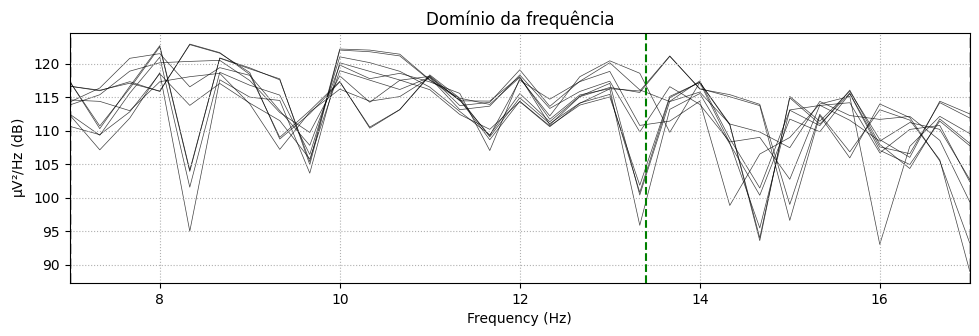

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


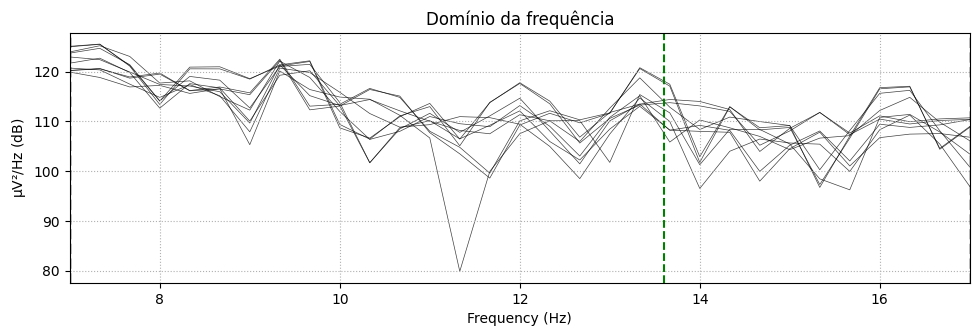

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


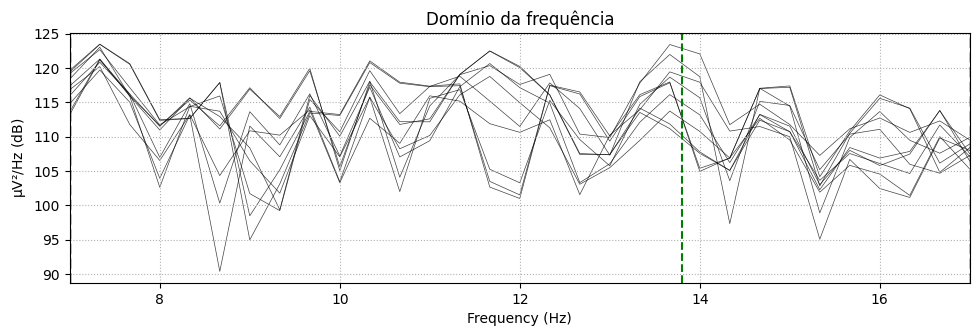

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


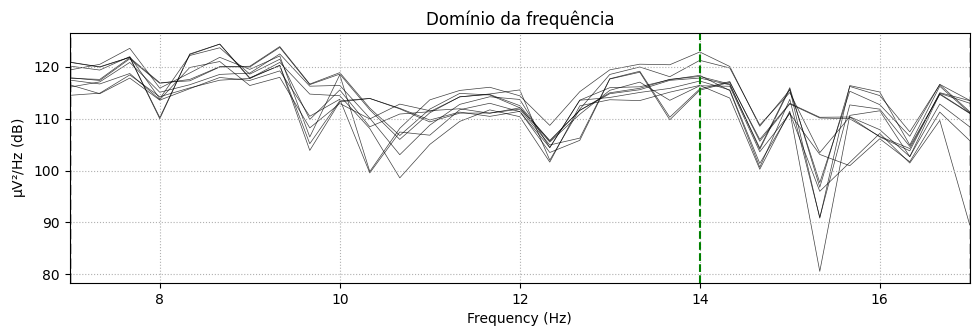

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


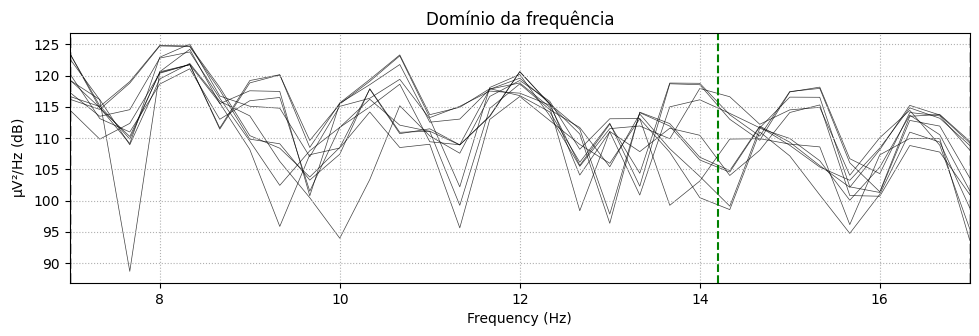

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


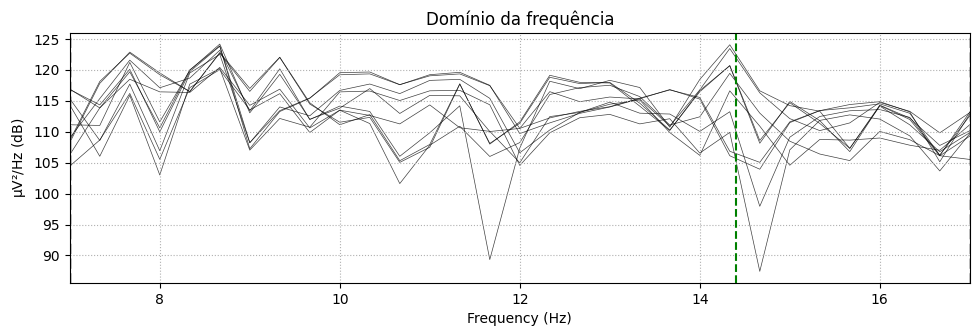

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


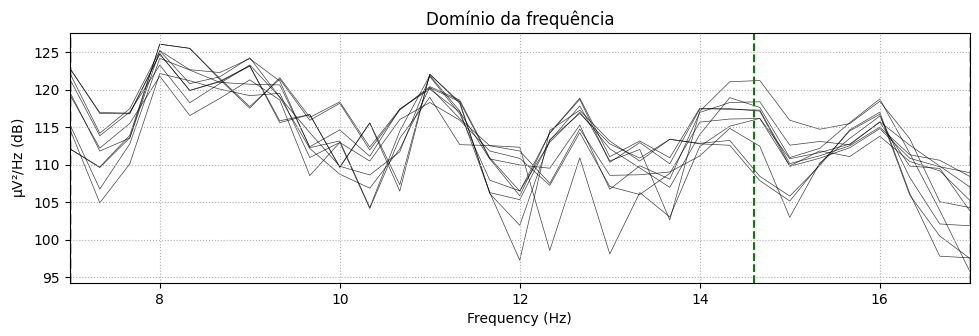

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


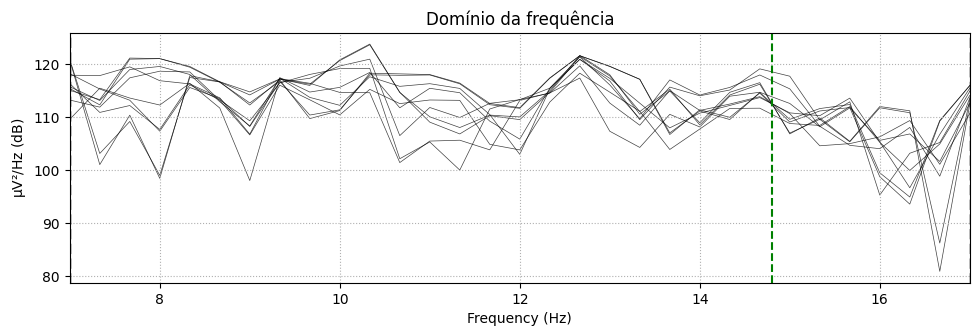

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


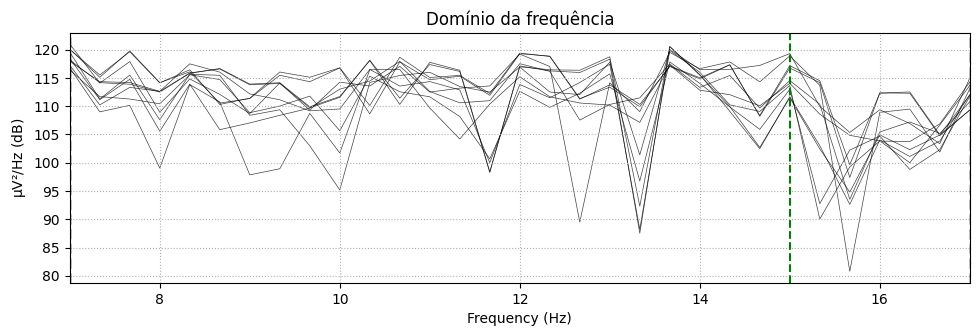

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


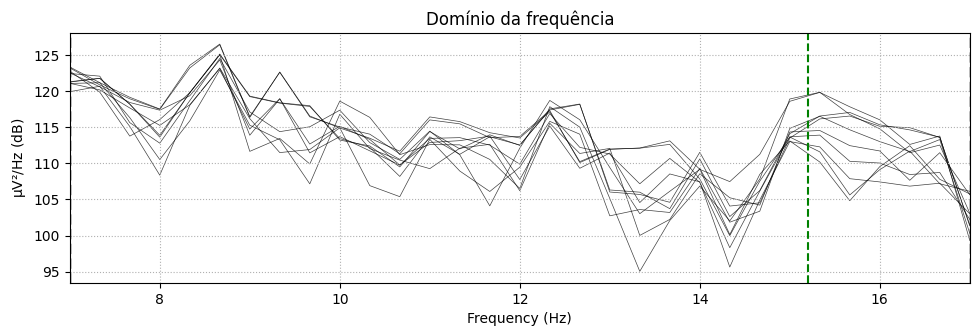

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


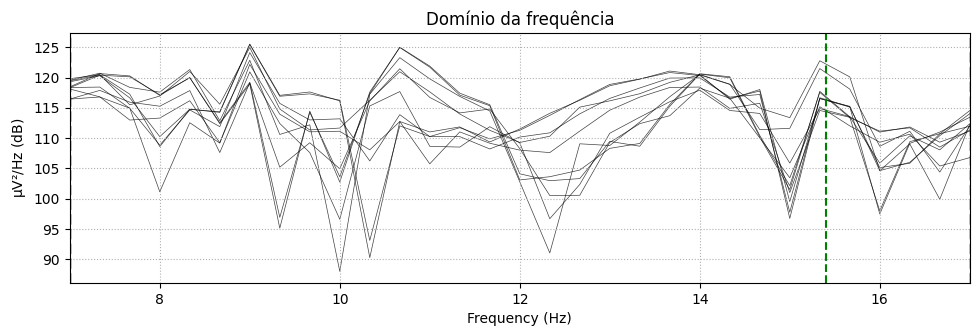

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


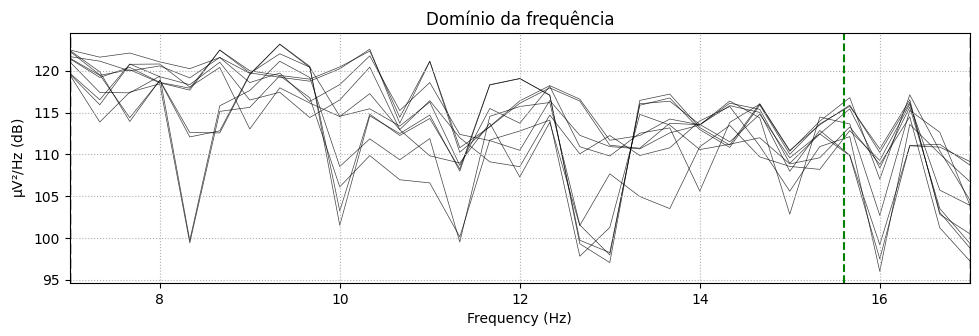

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


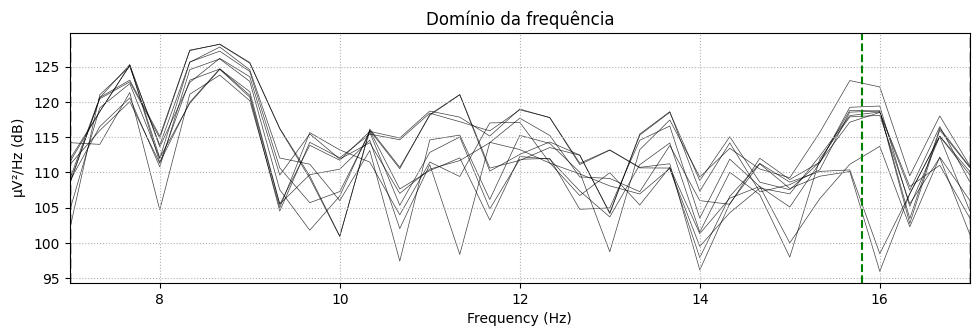

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


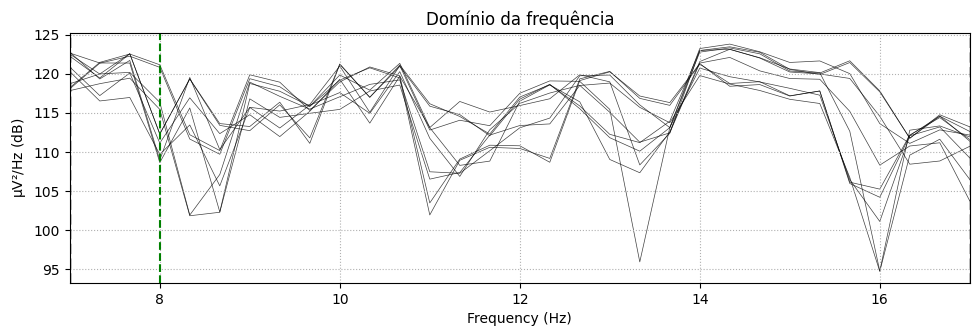

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


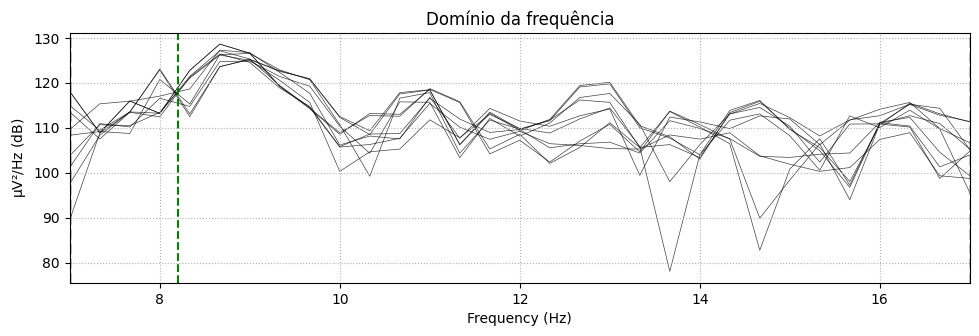

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


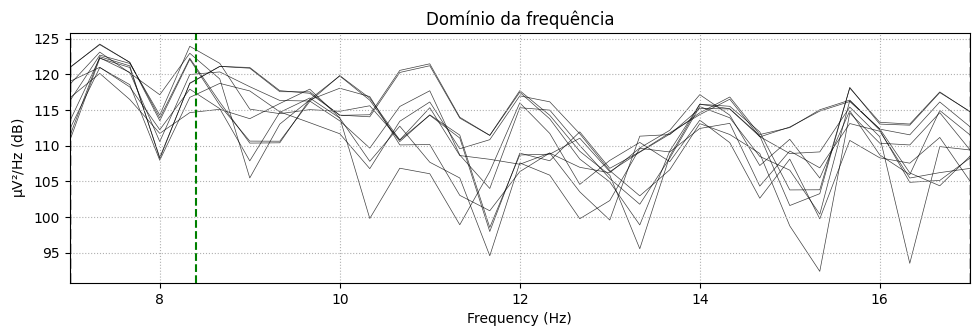

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


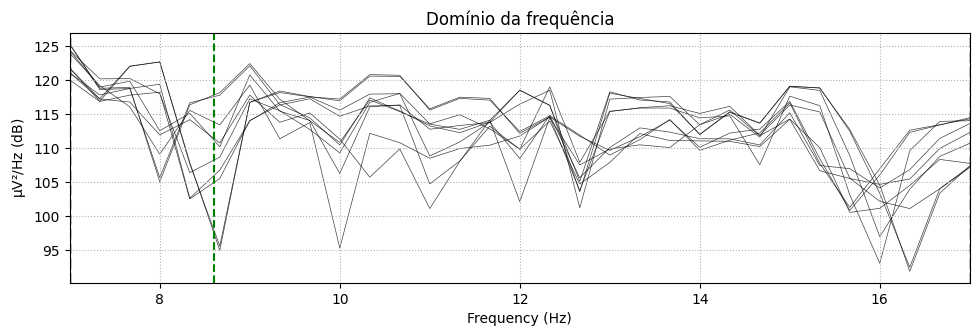

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


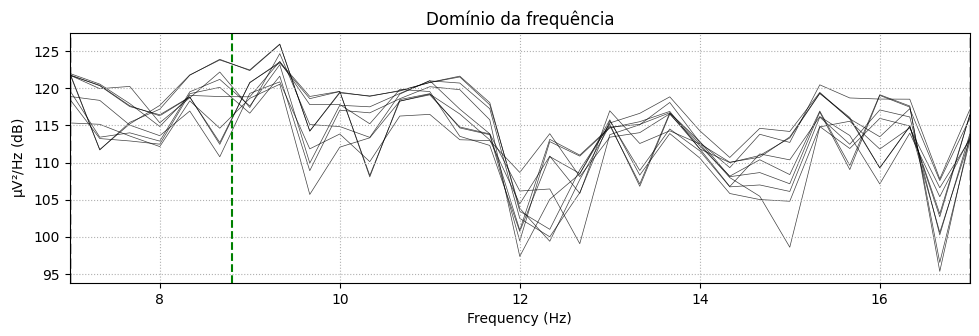

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


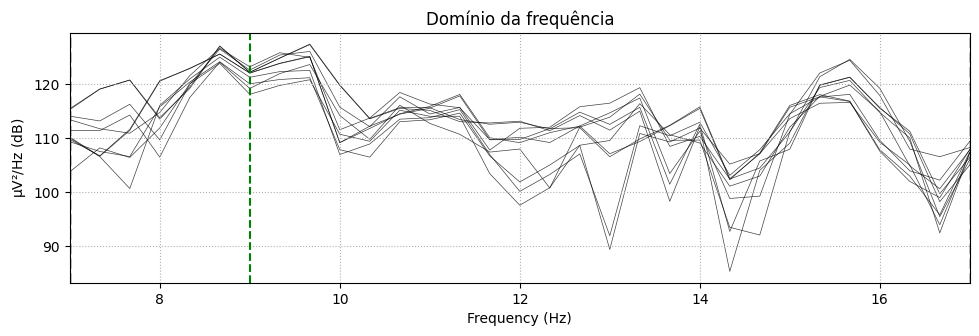

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


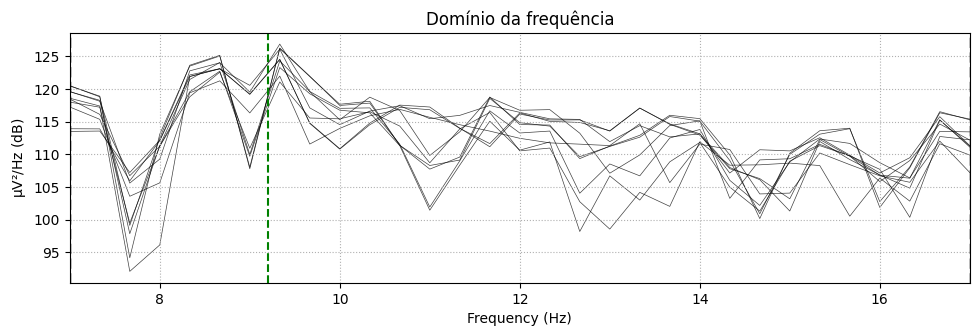

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


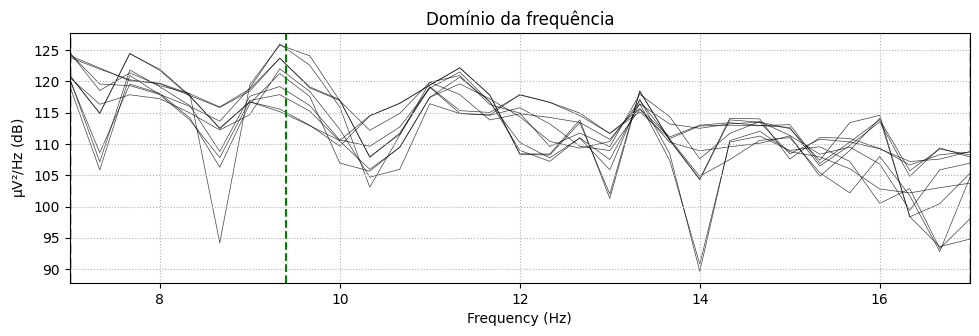

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


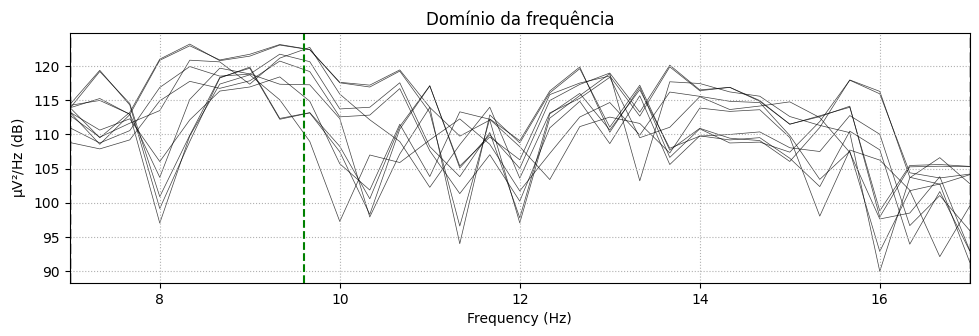

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


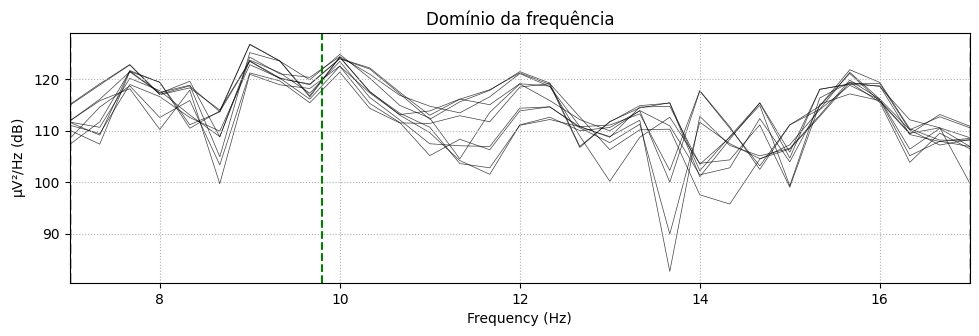

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


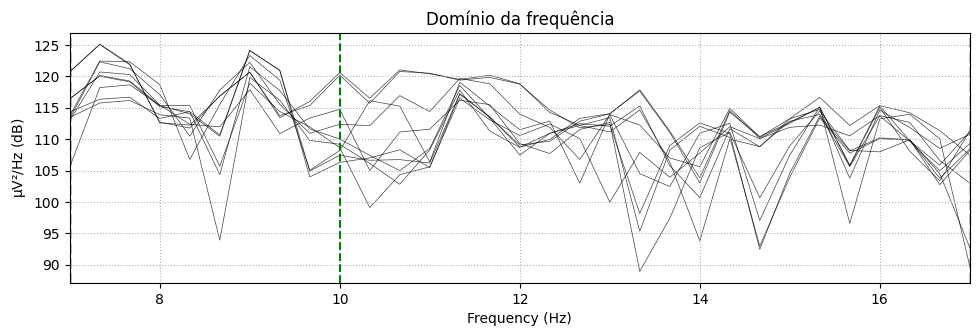

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


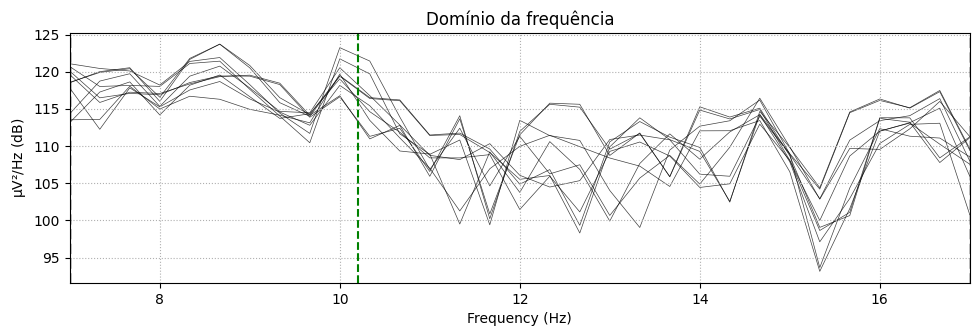

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


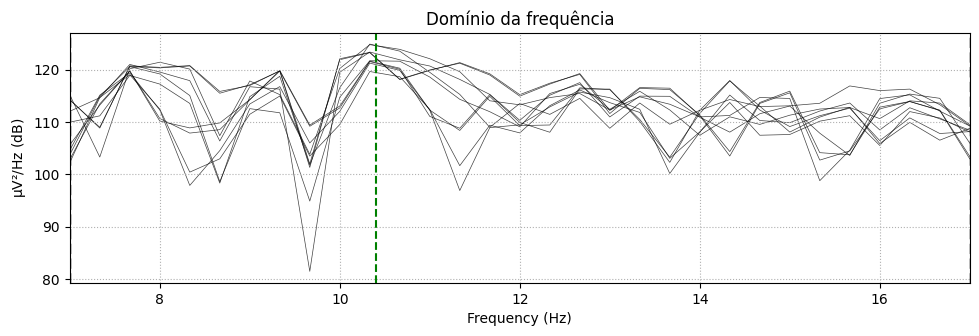

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


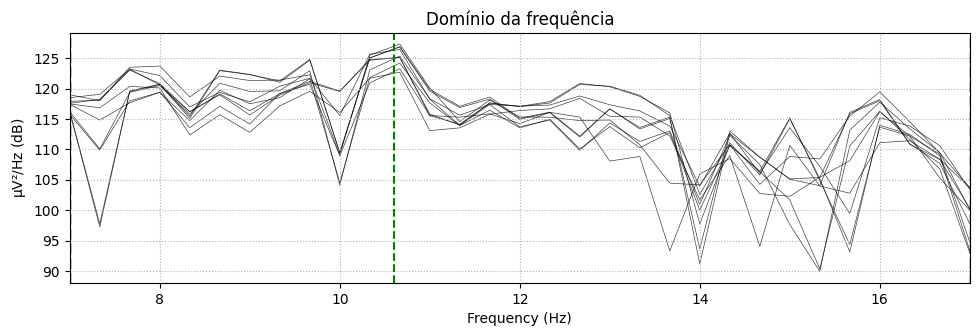

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


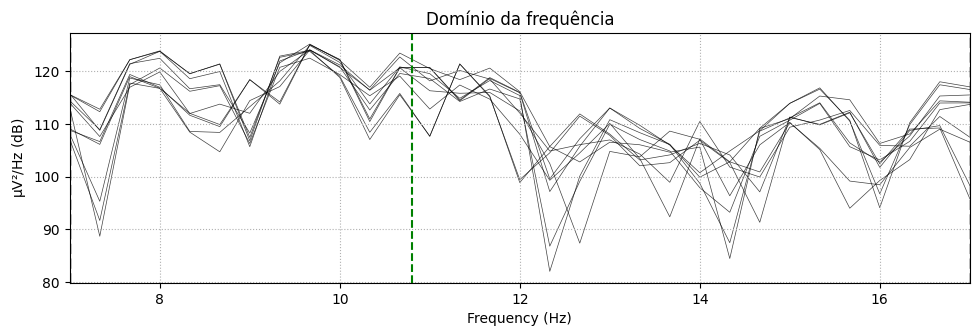

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


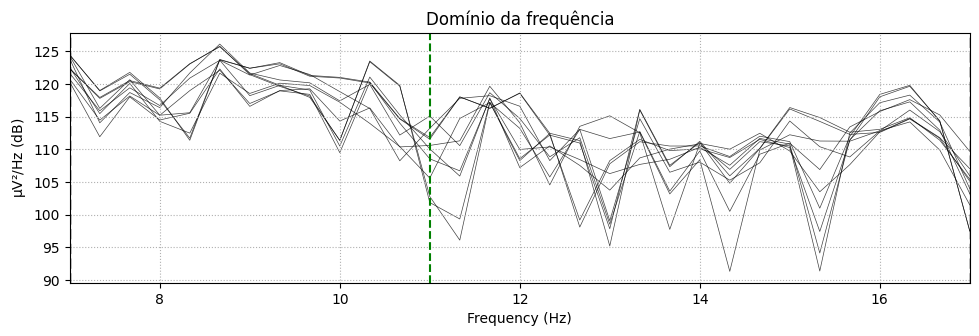

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


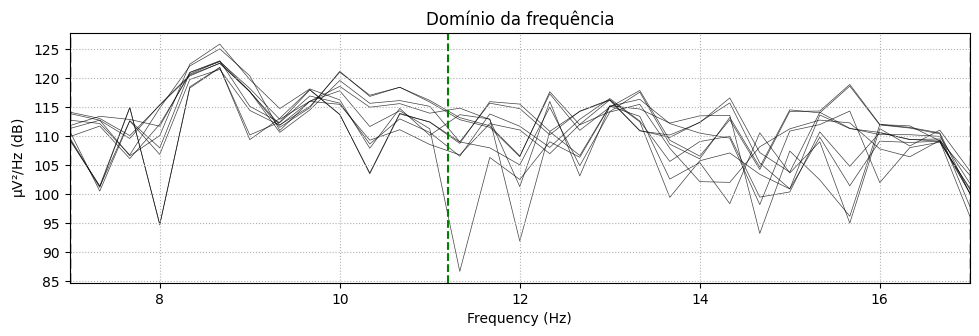

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


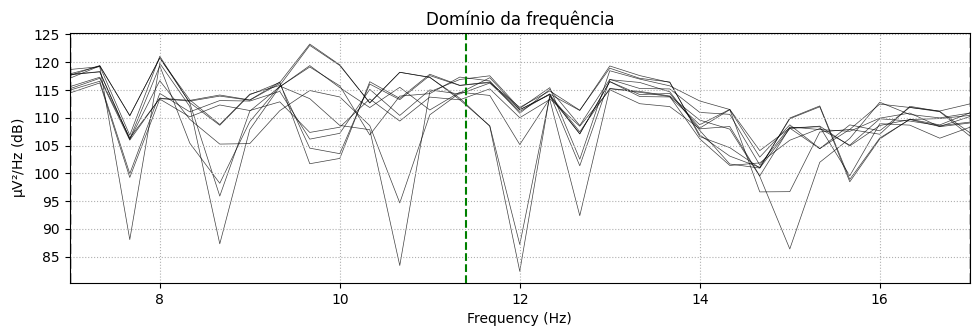

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


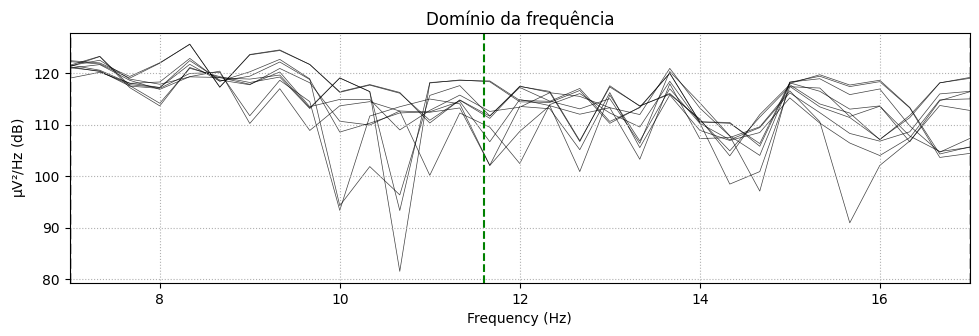

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


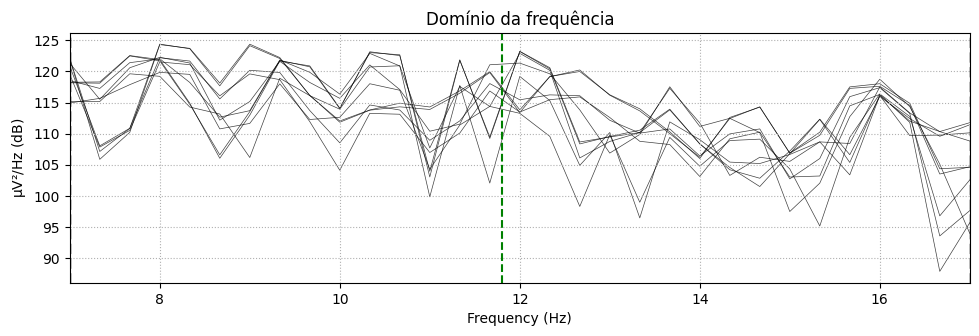

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


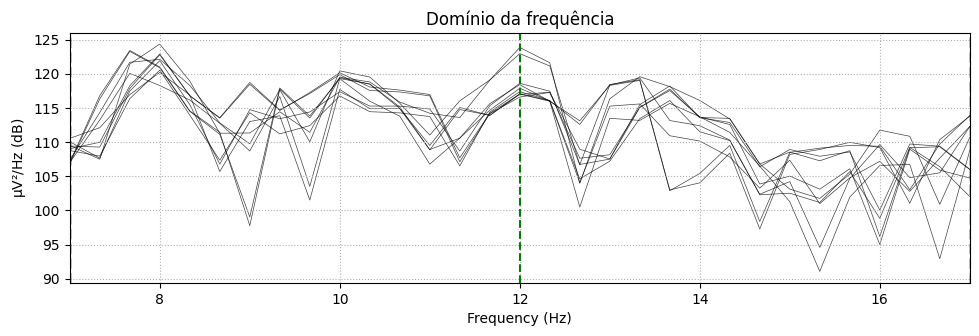

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


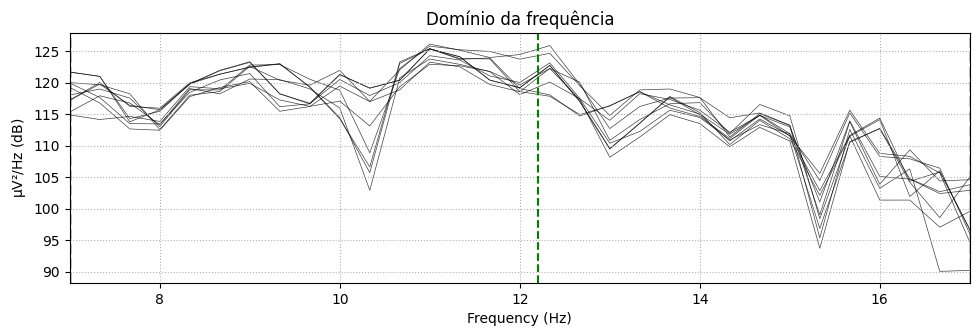

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


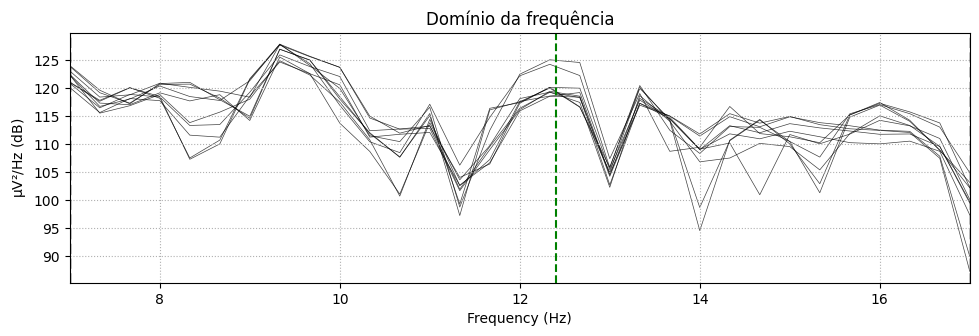

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


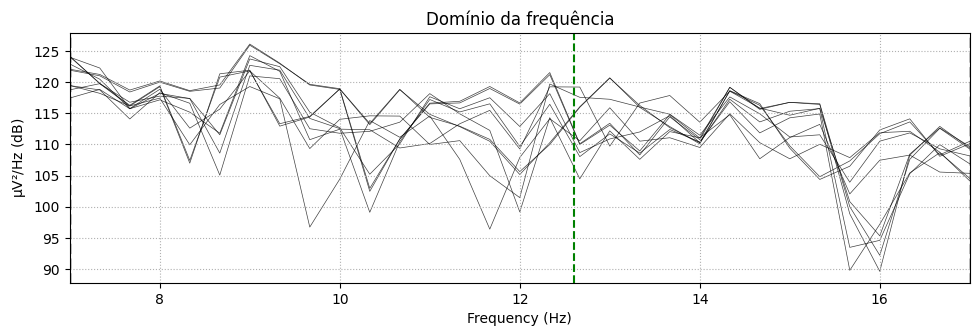

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


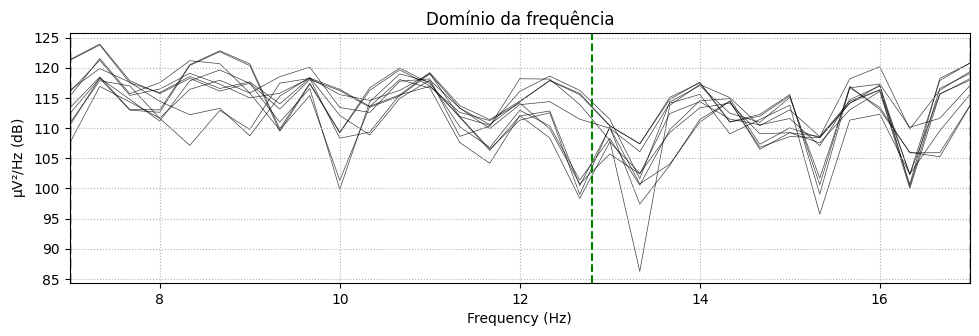

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


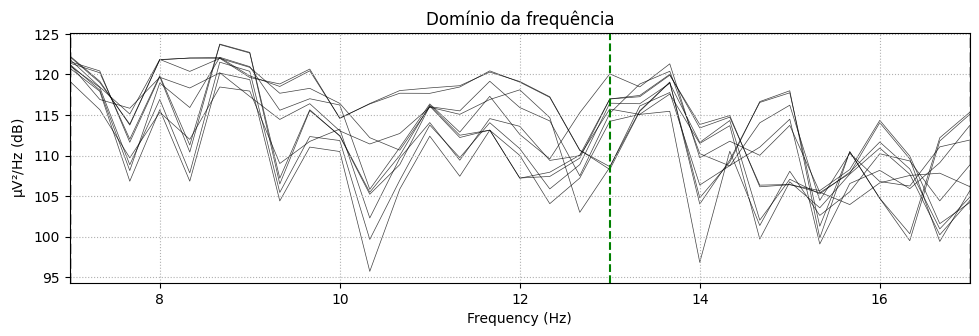

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


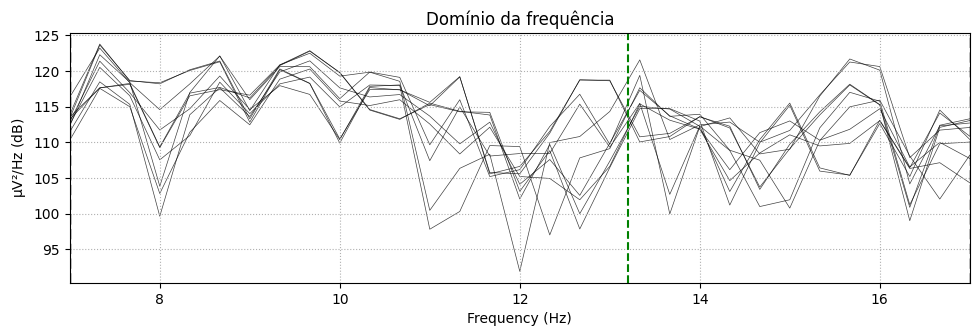

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


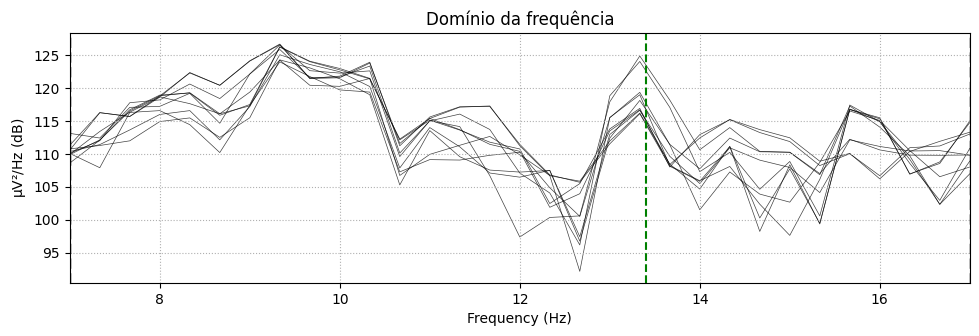

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


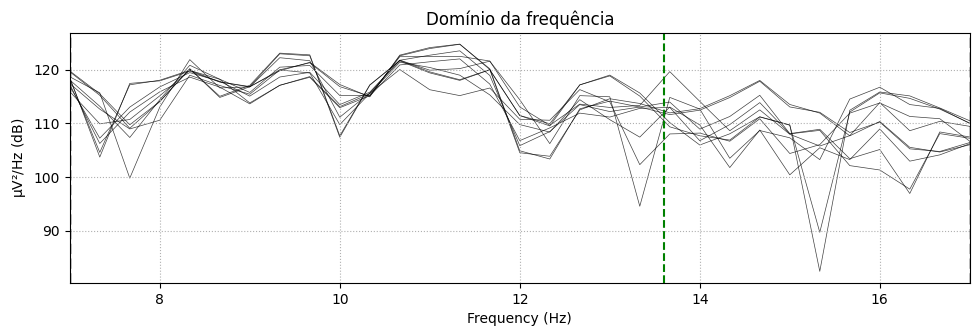

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


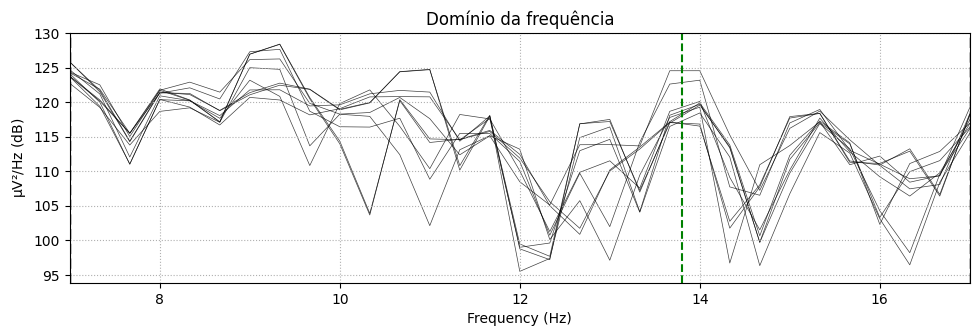

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


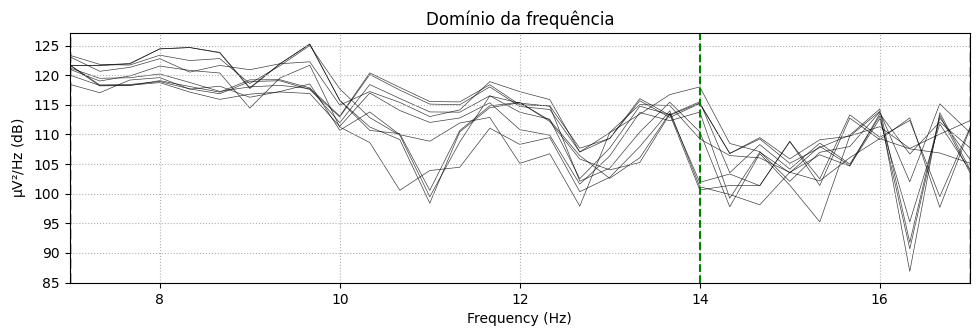

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


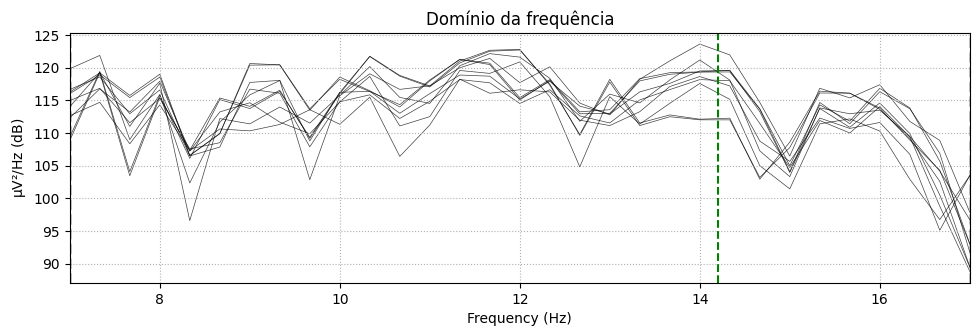

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


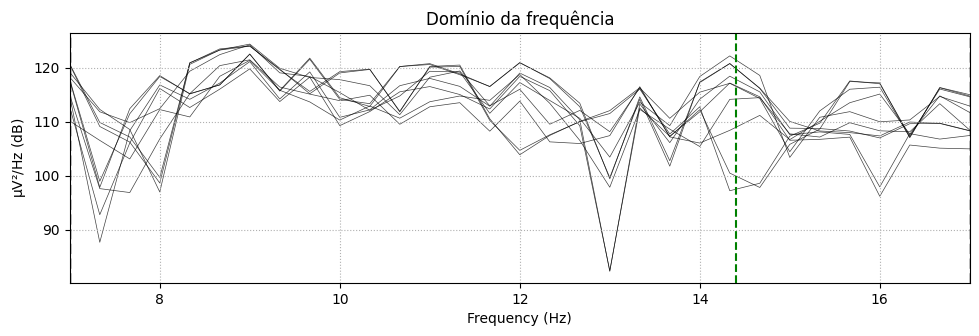

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


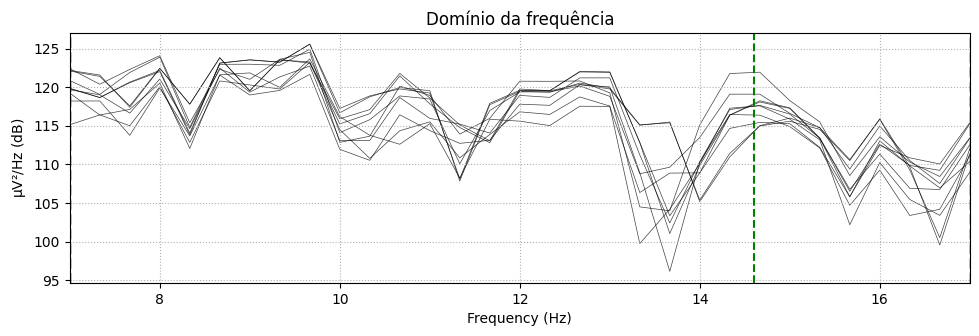

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


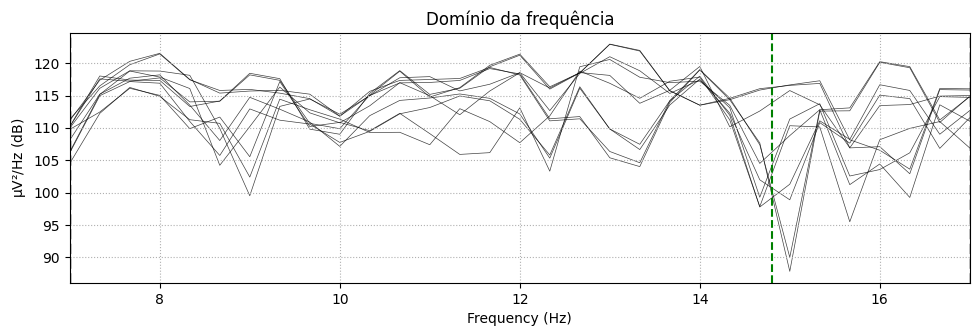

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


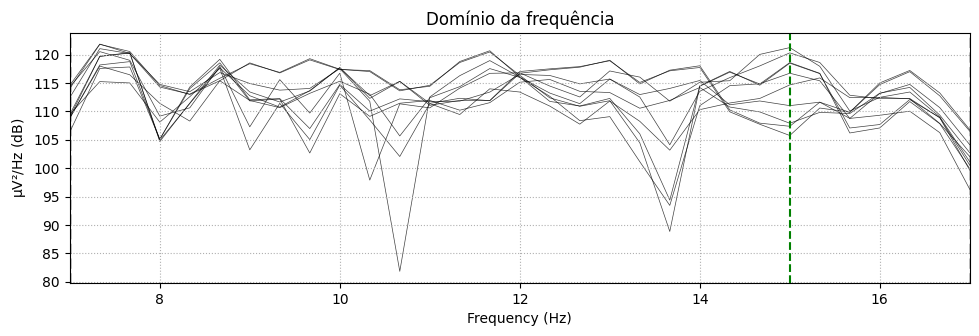

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


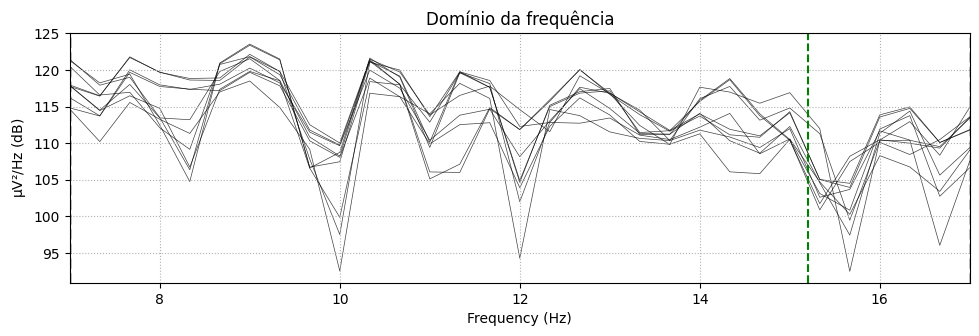

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


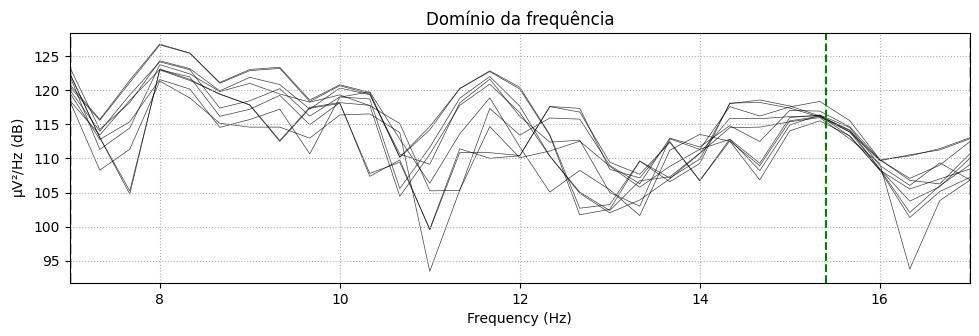

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


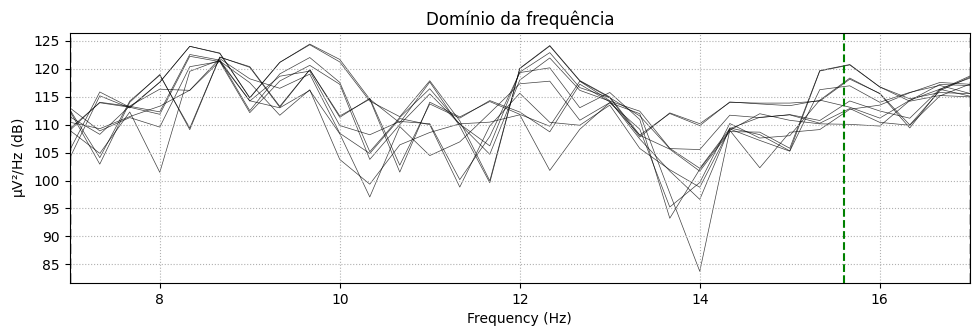

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


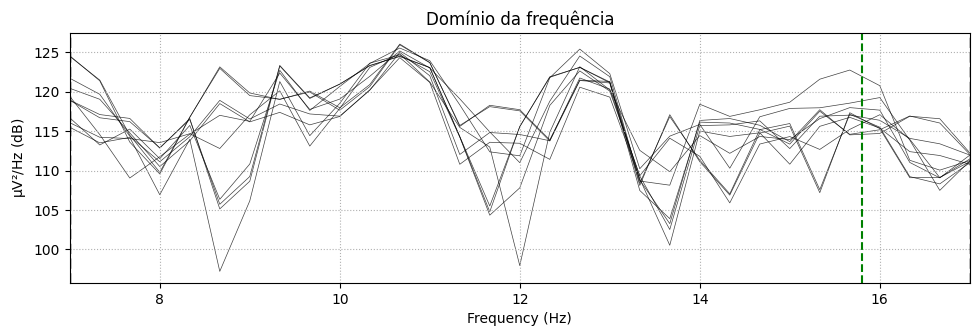

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


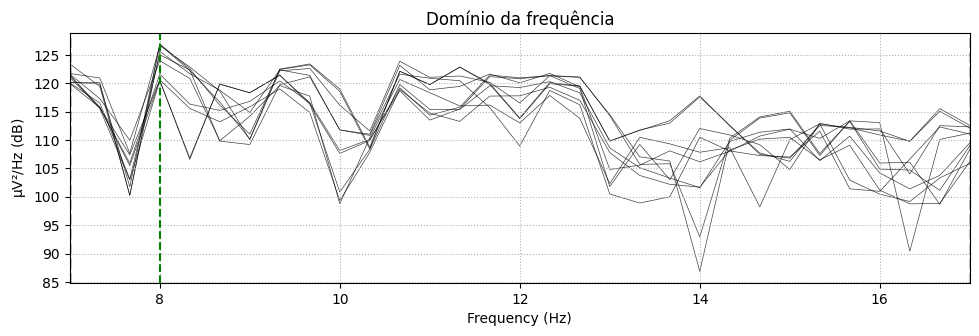

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


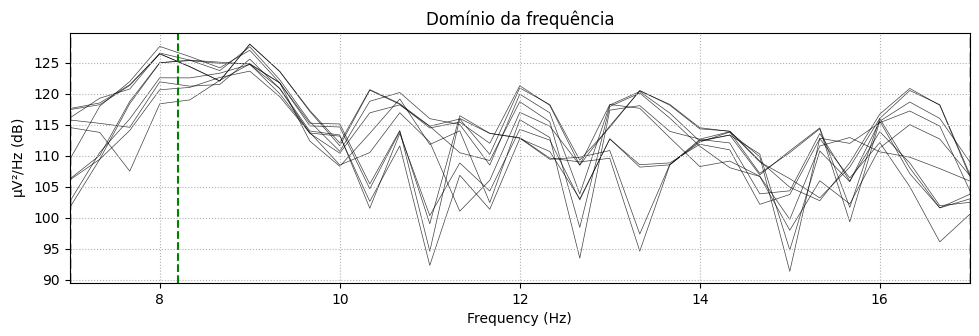

/tmp/ipykernel_16192/1617101651.py:6: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  view.plot(show=False)


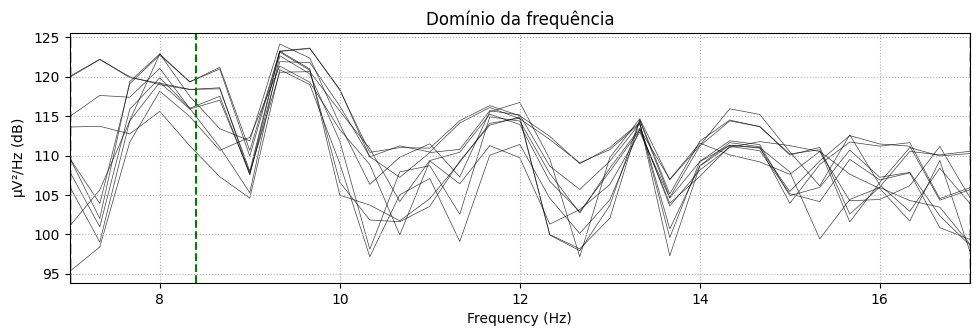

In [19]:
# tirar RuntimeWarning: Channel locations not available. Disabling spatial colors.
import warnings
warnings.filterwarnings('ignore')

for i in range(len(mne_data)):
    view = mne_data[i].compute_psd(method='welch', fmin=7, fmax=17, verbose=False) # ampliação do gráfico no domínio da frequência
    view.plot(show=False)
    print()
    plt.title('Domínio da frequência')
    plt.axvline(x=float(list(mne_data[i].event_id)[0]), linestyle='--',
                color='green')
    plt.show()
print()